<h1 style="text-align: center;"> Introduction to Computer Vision </h1>

In [ ]:
# Run this cell to install the necessary dependencies for this lecture
import sys
!{sys.executable} -m pip install numpy
!{sys.executable} -m pip install opencv-python
!{sys.executable} -m pip install matplotlib

<h2>Lecture 3 (Image interpolation and scaling)</h2>

<ul style="font-weight: 100;">
    <li><b>Image interpolation and scaling</b>
        <ul>
            <li>Image size scaling</li>
            <ul>
                <li>Nearest neighbor</li>
                <li>Triangle interpolation</li>
                <li>Bilinear interpolation</li>
                <li>Bicubic Interpolation</li>
                <li>Summary and some others</li>
            </ul>
            <li>Image size reduction</li>
            <ul>
                <li>Box filter</li>
                <li>Gaussean filter</li>
                <li>Filters for Images on OpenCV (summary and some others)</li>
                <li>Image De-noising - Non-Local Means Denoising</li>
            </ul>
            <li>Low-pass/High-pass Filters</li>
            <ul>
                <li>Simple Image Thresholding (With Global Value)</li>
                <li>Adaptive Thresholding (With Dynamic Value)</li>
                <li>Otsu's Binarization</li>
            </ul>
            <li>Histograms</li>
            <ul>
                <li>One-dimensional</li>
                <li>Multidimensional</li>
            </ul>
            <li>Morphological Transformations</li>
            <ul>
                <li>Dilation</li>
                <li>Erosion</li>
                <li>Opening</li>
                <li>Closing</li>
                <li>Gradiant</li>
                <li>Tophat</li>
                <li>blackhat</li>
                <li>Structuring Elements</li>
                <li>Thinning</li>
                <li>Thickening</li>
                <li>Skeletonization (Medial Axis Transform)</li>
            </ul>
            <li>Bitwise Operations</li>
            <ul>
                <li>AND</li>
                <li>OR</li>
                <li>XOR</li>
                <li>NOT - square</li>
            </ul>
            <li>Find Edges</li>
            <ul>
                <li>Properties of convolutions</li>
                <ul>
                    <li>Commutative property</li>
                    <li>Associative property</li>
                    <li>Distribution property over addition</li>
                    <li>Scalable property</li>
                </ul>
                <li>Sobel filters</li>
                <ul>
                    <li>Sobel X</li>
                    <li>Sobel Y</li>
                    <li>Sobel XY</li>
                    <li>Sobel Combined</li>
                </ul>
                <li>Laplacian</li>
                <li>Gaussian difference (DoG)</li>
                <li>Sharpen</li>
                <ul>Sharpen
                    <li>Identity Kernel </li>
                    <li>Sharpen Kernel</li>
                </ul>
                <li>Canny Edge Detector</li>
            </ul>
        </ul>
    </li>
</ul>

<h2>Lecture 3 (Image interpolation and scaling)</h2>

In the previous lectures we studied from how the human eye sees to how PC's receive and process the pixels and colors of an image, and also some tools to take advantage of this, But as we continue to think about the history of dealing with images, the next task we come across may seem very intuitive or easy at this point, but it really was and is a relatively complex problem, whose solution would open the world to endless possibilities, the problem I am talking about is the <b>rescaling of images</b>, will see how it evolved and where it took us.

<h2>Image size scaling</h2>

<h3>Nearest neighbor</h3>

Nearest neighbor is the simplest and fastest implementation of image scaling technique. It is very useful when speed is the main concern, for example when zooming image for editing or for a thumbnail preview.

<img src="Assets/NN.gif">

Scaling algorithm is to find appropiate spot to put the empty spaces inside the original image, and to fill all those spaces with livelier colors. For the nearest neighbor technique, the empty spaces will be replaced with the nearest neighboring pixel, hence the name. This results in a sharp but jaggy image, and if the enlarge scale is two, it would seems each pixel has doubled in size. Shrinking, in the other hand involves reduction of pixels and it means lost of irrecoverable information. In this case scaling algorithm is to find the right pixels to throw away.

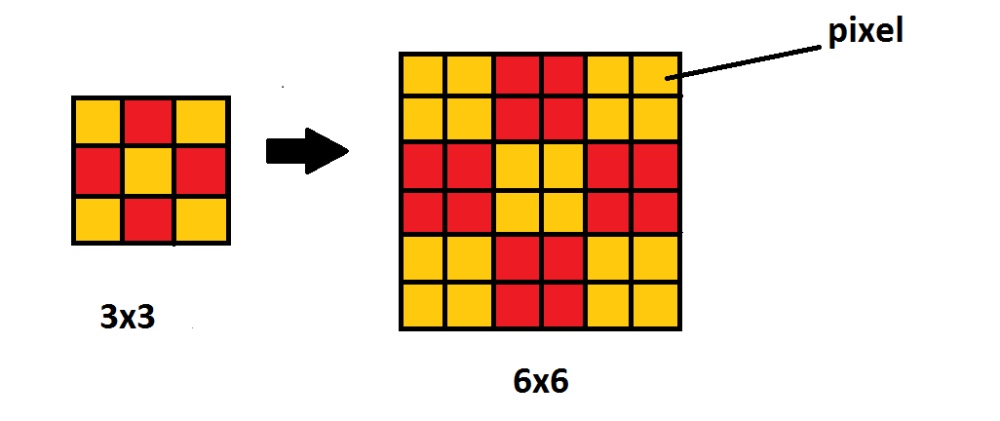

For upscaling this means multiple pixels of the same color will be present. This can preserve sharp details in pixel art, but also introduce jaggedness in previously smooth images.

The procedure is simple, first we superimpose our new grid of pixels on the old grid of pixels, each pixel is represented as a point in the center of the square pixel, then we only look for the central point of a pixel closest to the central point of our new grid, this can be seen illustrated in the gif above, There are several ways to implement this algorithm, one can be by checking the Euclidean distance (hypotenuse) or the distance between pixels (distance in "X" and distance in "Y"), or interpolating as in the bilinear method (explained below) but without taking into account the magnitudes of all the pixels, only the proximity.

For the raw example we are going to use the image just in gray scale, this is to deal only with one channel but the process is the same for all the three channels

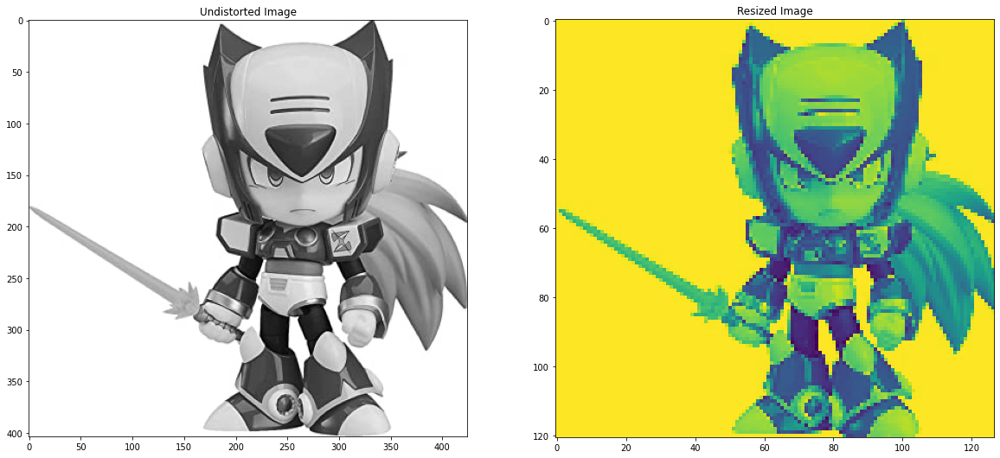

In [38]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread("Assets/Zero.jpg")
img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

scaleX = 0.3
scaleY = 0.3

newImg = np.zeros((int(img.shape[0]*scaleX),int(img.shape[1]*scaleY))).astype(np.uint8)

for y in range(newImg.shape[0]):
    for x in range(newImg.shape[1]):
        samplex = x/scaleX
        sampley = y/scaleY
        dx = samplex - np.floor(samplex)
        dy = sampley - np.floor(sampley)

        val = img[int(sampley-dy),int(samplex-dx)]*(1-dx)*(1-dy)
        val += img[int(sampley + 1 - dy),int(samplex-dx)]*(1-dx)*(dy) 
        val += img[int(sampley-dy),int(samplex + 1 - dx)]*(dx)*(1-dy)
        val += img[int(sampley + 1 -dy),int(samplex + 1 - dx)]*(dx)*(dy)

        newImg[y,x] = val.astype(np.uint8)


fig, axs = plt.subplots(1,2, figsize=(20, 10))
axs[0].set_title('Undistorted Image')
axs[0].imshow(img, cmap='gray')
axs[1].set_title('Resized Image')
axs[1].imshow(newImg)
plt.show()

The color of the second Image it's because of the way Matplotlib maps single-channel output. It defaults to the "perceptially uniform" colourmap: blue->yellow; a bit like how you might expect a heatmap to be from blue to red, but theoretically clearer for human vision.

There's some more details here that might help: https://matplotlib.org/users/colormaps.html (You need to tell it to use the gray colourmap when you show the image: plt.imshow(arr, cmap='gray') )

<h4>With OpenCV</h4>

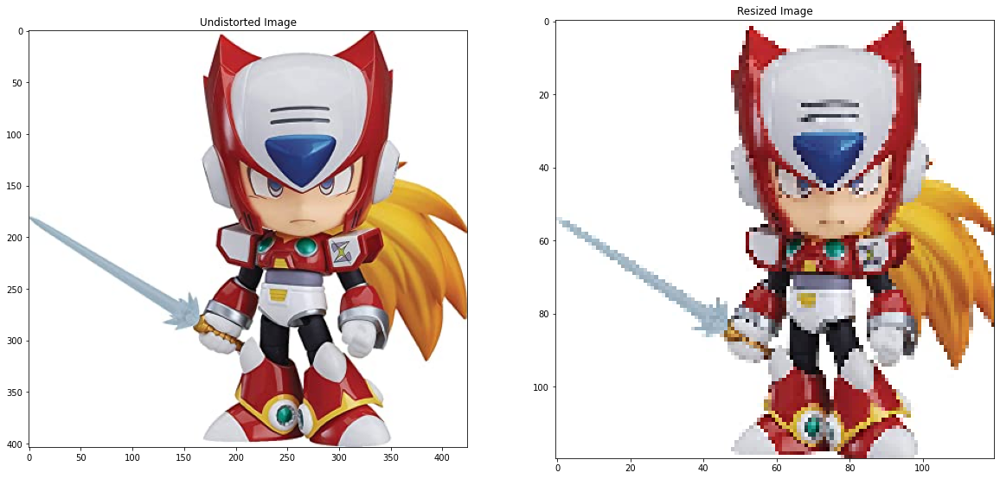

In [6]:
import cv2
import matplotlib.pyplot as plt

im = cv2.imread('Assets/Zero.jpg')
im_resized = cv2.resize(im, (120, 120), interpolation=cv2.INTER_NEAREST)


fig, axs = plt.subplots(1,2, figsize=(20, 10))
axs[0].set_title('Undistorted Image')
axs[0].imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
axs[1].set_title('Resized Image')
axs[1].imshow(cv2.cvtColor(im_resized, cv2.COLOR_BGR2RGB))
plt.show()

<h3>Triangle interpolation</h3>

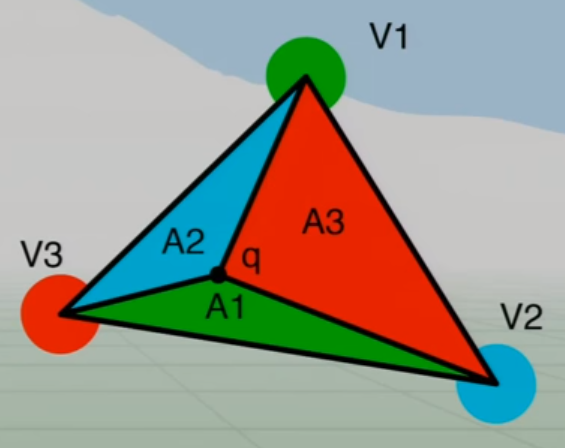



When the grid has an unorganized structure (or in any other case where applicable), we seeks to form a triangle with the 3 elements closest to the point and find the distance between them, which would work in an equilateral triangle, but when it is not (distances give us large numbers when we are far away, and small numbers when we are close) We could try inverting them so that the larger numbers give more weight to the closest vertices. In other words, we will interpolate inversely proportional to the distance to each vertex.

Then the procedure will be to draw a line between the three points forming a triangle and a line between each one and the point to determine the value, the area of the triangles is taken and normalized to one, in such a way that the sum of all the areas give as a result the value of the point (A1 + A2 + A3) = 1

Using the opposite distances to add the color our equation would look like:

\begin{align*}Q=A1*v1+A2*v2+A3*v3\end{align*}

Another thing about barcentric coordinates is that if P (the point) is really outside the triangle, at least one of W1, W2, or W3 will be negative! This can be used as an easy check to see if a point is inside or outside of a triangle.

<h3>Bilinear interpolation</h3>

Bilinear Interpolation uses a weighted average of the four nearest cell centers. The closer an input cell center is to the output cell center, the higher the influence of its value is on the output cell value. This means that the output value could be different than the nearest input, but is always within the same range of values as the input. Since the values can change, Bilinear is not recommended for categorical data. Instead, it should be used for continuous data like elevation and raw slope values.

by interpolating pixel color values, introducing a continuous transition into the output even where the original material has discrete transitions. Although this is desirable for continuous-tone images, this algorithm reduces contrast (sharp edges) in a way that may be undesirable for line art.

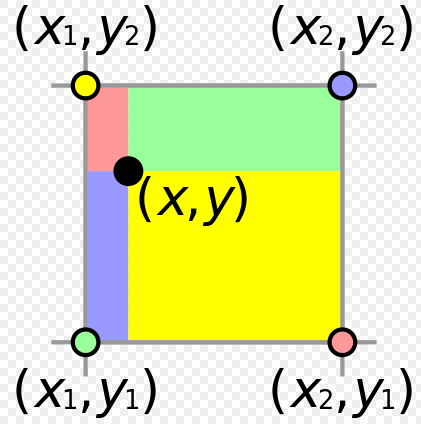



The concept is the same as in the triangular interpolation, the color attributes according to the inverse of its area, in order to get the final color it can be done in two ways, such as the sum of its areas by the color:

\begin{align*}Q=A1*v1+A2*v2+A3*v3+A4*v4\end{align*}

Or as the sum of its axes, that is, first interpolating the "X" axis and taking the resulting color, and the same with the "Y" axis to finally interpolate the two resulting colors

\begin{align*}Q1=A1*v1+A2*v2\end{align*}
\begin{align*}Q2=A3*v3+A4*v4\end{align*}
\begin{align*}Q3=Q1*v5+Q2*v6\end{align*}

This interpolation is limited to 2 times its size and generates a star effect in the images

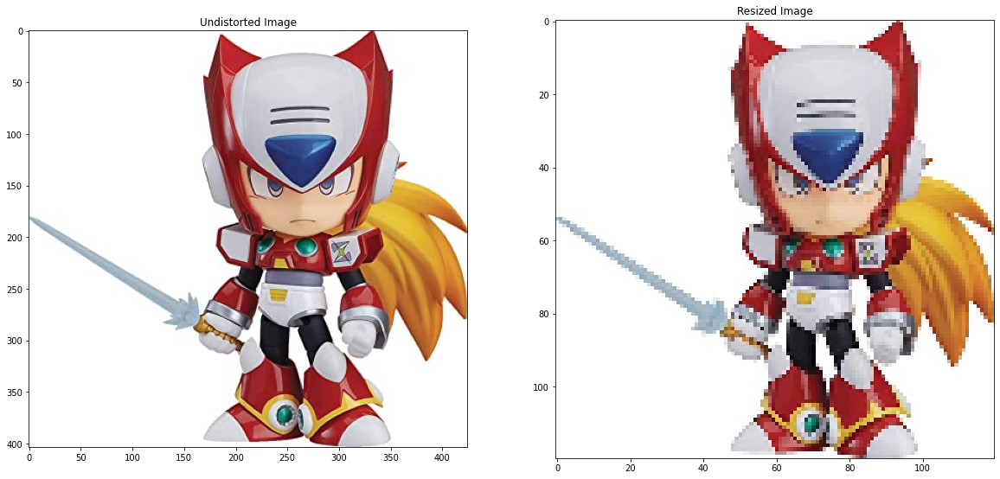

In [7]:
import cv2
import matplotlib.pyplot as plt

im = cv2.imread('Assets/Zero.jpg')
im_resized = cv2.resize(im, (120, 120), interpolation=cv2.INTER_LINEAR)


fig, axs = plt.subplots(1,2, figsize=(20, 10))
axs[0].set_title('Undistorted Image')
axs[0].imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
axs[1].set_title('Resized Image')
axs[1].imshow(cv2.cvtColor(im_resized, cv2.COLOR_BGR2RGB))
plt.show()

As you can see in the image below, the way to apply this interpolation is to superimpose the new resolution of the image on the existing image and use the distance between the center of the pixel and the center of the previous pixels of the image to get the new values, There is still a problem with this procedure and it is that four points are needed to interpolate then what to do with the points on the edges that only have two points to reference and not four?, the solution to this is to simply add white pixels to the sides in the form of padding so that they all have four reference points

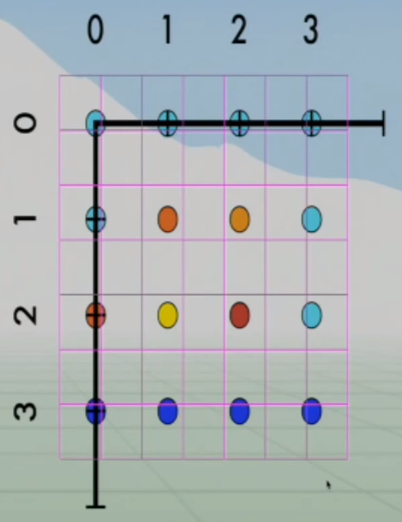



<h3>Bicubic Interpolation</h3>

This technique uses the same interpolation as bilinear but also interpolates within the 3 RGB channels. This is a much slower algorithm, since it takes time to process when resampling an image. The results are much smoother looking images with less artifacts. This algorithm produces the best results out of the three discussed

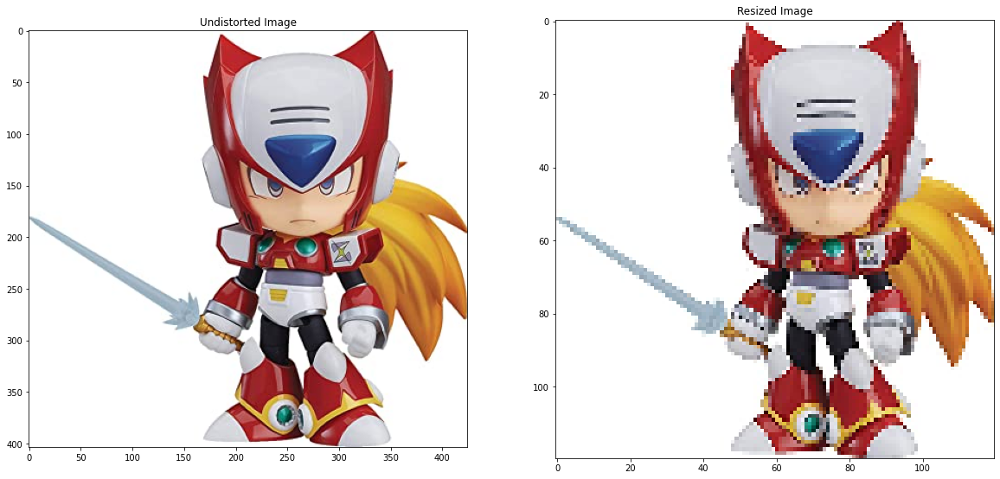

In [21]:
import cv2
import matplotlib.pyplot as plt

im = cv2.imread('Assets/Zero.jpg')
im_resized = cv2.resize(im, (120, 120), interpolation=cv2.INTER_CUBIC)


fig, axs = plt.subplots(1,2, figsize=(20, 10))
axs[0].set_title('Undistorted Image')
axs[0].imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
axs[1].set_title('Resized Image')
axs[1].imshow(cv2.cvtColor(im_resized, cv2.COLOR_BGR2RGB))
plt.show()

This interpolation does not generate the star effect that bilinear generates, but rather gives more blurred edges, this can also be a problem when scaling the image a lot because the edges are lost and colors are created that were not originally in the image (due to the blurred of these)

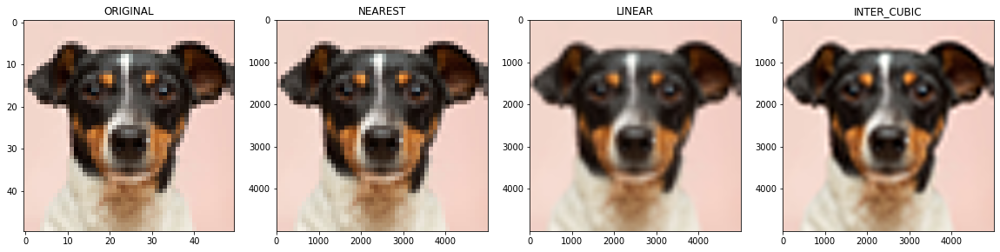

In [18]:
import cv2
import matplotlib.pyplot as plt

im = cv2.imread('Assets/DOGFACE.png')
NEAREST = cv2.resize(im, (5000, 5000), interpolation=cv2.INTER_NEAREST)
LINEAR = cv2.resize(im, (5000, 5000), interpolation=cv2.INTER_LINEAR)
INTER_CUBIC = cv2.resize(im, (5000, 5000), interpolation=cv2.INTER_CUBIC)


fig, axs = plt.subplots(1,4, figsize=(20, 10))
axs[0].set_title('ORIGINAL')
axs[0].imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
axs[1].set_title('NEAREST')
axs[1].imshow(cv2.cvtColor(NEAREST, cv2.COLOR_BGR2RGB))
axs[2].set_title('LINEAR')
axs[2].imshow(cv2.cvtColor(LINEAR, cv2.COLOR_BGR2RGB))
axs[3].set_title('INTER_CUBIC')
axs[3].imshow(cv2.cvtColor(INTER_CUBIC, cv2.COLOR_BGR2RGB))
plt.show()

<h2>Image interpolation and scaling (summary and some others)</h2>

<b>Nearest-neighbor interpolation</b>
One of the simpler ways of increasing image size is nearest-neighbor interpolation, replacing every pixel with the nearest pixel in the output; for upscaling this means multiple pixels of the same color will be present. This can preserve sharp details in pixel art, but also introduce jaggedness in previously smooth images. 'Nearest' in nearest-neighbor doesn't have to be the mathematical nearest. One common implementation is to always round towards zero. Rounding this way produces fewer artifacts and is faster to calculate.

<b>Bilinear and bicubic algorithms</b>
Bilinear interpolation works by interpolating pixel color values, introducing a continuous transition into the output even where the original material has discrete transitions. Although this is desirable for continuous-tone images, this algorithm reduces contrast (sharp edges) in a way that may be undesirable for line art. Bicubic interpolation yields substantially better results, with an increase in computational cost.

<b>Sinc and Lanczos resampling</b>
Sinc resampling in theory provides the best possible reconstruction for a perfectly bandlimited signal. In practice, the assumptions behind sinc resampling are not completely met by real-world digital images. Lanczos resampling, an approximation to the sinc method, yields better results. Bicubic interpolation can be regarded as a computationally efficient approximation to Lanczos resampling.

<b>Box sampling</b>
One weakness of bilinear, bicubic and related algorithms is that they sample a specific number of pixels. When down scaling below a certain threshold, such as more than twice for all bi-sampling algorithms, the algorithms will sample non-adjacent pixels, which results in both losing data, and causes rough results.

The trivial solution to this issue is box sampling, which is to consider the target pixel a box on the original image, and sample all pixels inside the box. This ensures that all input pixels contribute to the output. The major weakness of this algorithm is that it is hard to optimize. 

<b>Mipmap</b>
Another solution to the downscale problem of bi-sampling scaling are mipmaps. A mipmap is a prescaled set of downscale copies. When downscaling the nearest larger mipmap is used as the origin, to ensure no scaling below the useful threshold of bilinear scaling is used. This algorithm is fast, and easy to optimize. It is standard in many frameworks such as OpenGL. The cost is using more image memory, exactly one third more in the standard implementation.

<b>Fourier-transform methods</b>
Simple interpolation based on Fourier transform pads the frequency domain with zero components (a smooth window-based approach would reduce the ringing). Besides the good conservation (or recovery) of details, notable is the ringing and the circular bleeding of content from the left border to right border (and the other way around).

<b>Edge-directed interpolation</b>
Edge-directed interpolation algorithms aim to preserve edges in the image after scaling, unlike other algorithms, which can introduce staircase artifacts.

Examples of algorithms for this task include New Edge-Directed Interpolation (NEDI), Edge-Guided Image Interpolation (EGGI), Iterative Curvature-Based Interpolation (ICBI), and Directional Cubic Convolution Interpolation (DCCI) A 2013 analysis found that DCCI had the best scores in PSNR and SSIM on a series of test images.

<b>hqx</b>
For magnifying computer graphics with low resolution and/or few colors (usually from 2 to 256 colors), better results can be achieved by hqx or other pixel-art scaling algorithms. These produce sharp edges and maintain high level of detail.

<b>Vectorization</b>
Vector extraction, or vectorization, offer another approach. Vectorization first creates a resolution-independent vector representation of the graphic to be scaled. Then the resolution-independent version is rendered as a raster image at the desired resolution. This technique is used by Adobe Illustrator, Live Trace, and Inkscape. Scalable Vector Graphics are well suited to simple geometric images, while photographs do not fare well with vectorization due to their complexity.

<b>Deep convolutional neural networks</b>
This method uses machine learning for more detailed images such as photographs and complex artwork. Programs that use this method include waifu2x, Imglarger and Neural Enhance

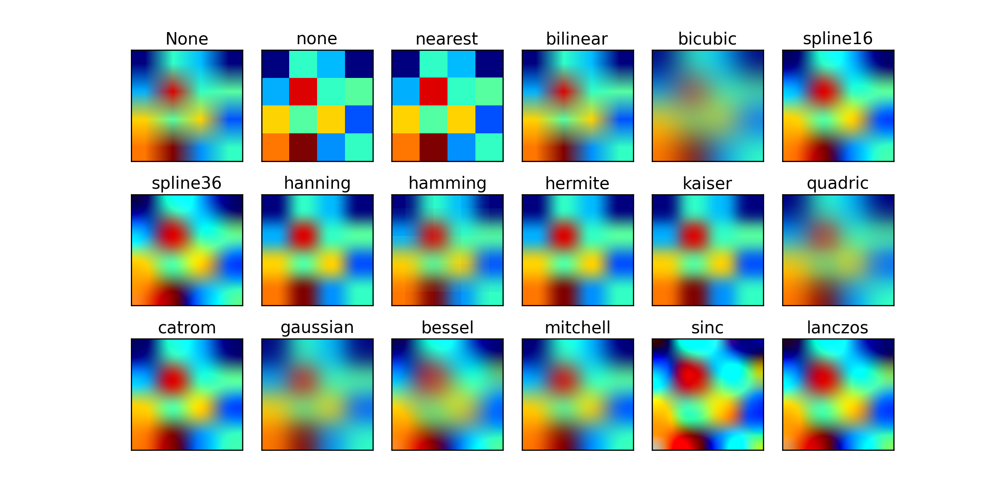

<h2>Image size reduction</h2>

Until now everything works relatively well, the problem occurs when trying to reduce the size of an image with any of these methods

If we want to apply the bilinear interpolation method, our point will be somewhere in the image in the middle of 4 points, which we will use as a reference to interpolate and get a value for our pixel in the new image (ignoring all other colors outside the limits in which it is)

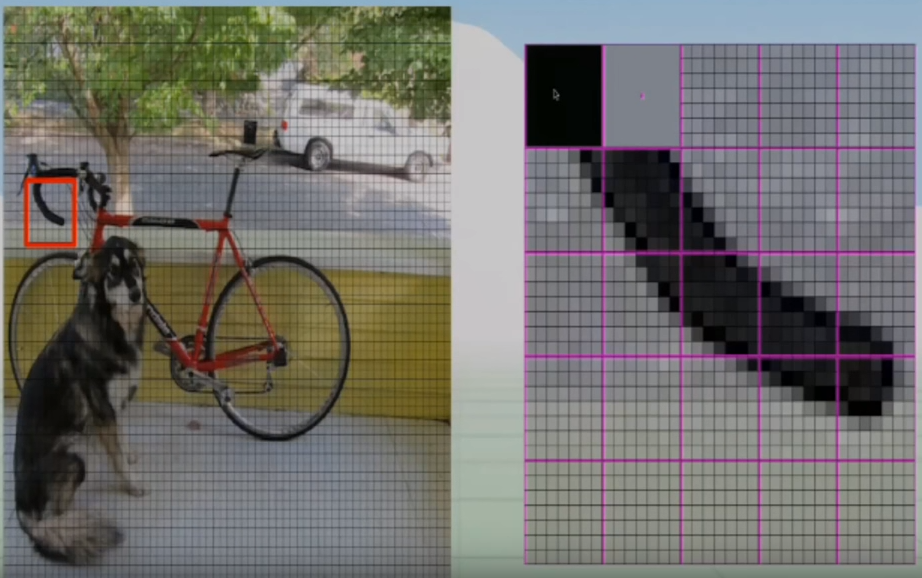



This results in a very pixelated image and with some recorded errors caused by garbage or the salt and pepper effect in the images

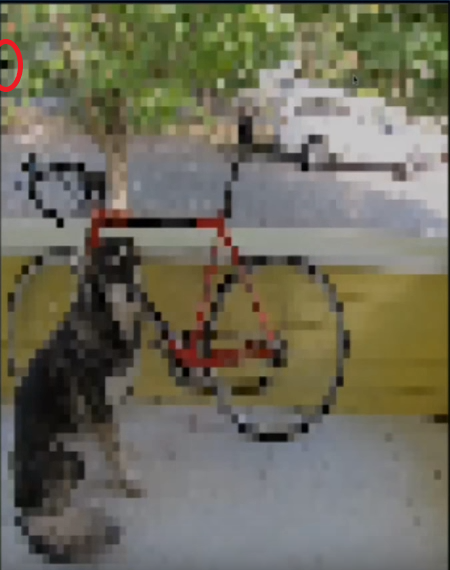



In this case the new reference point is a black pixel in a predominantly green image, but since the adjacent points are black, this pixel becomes black

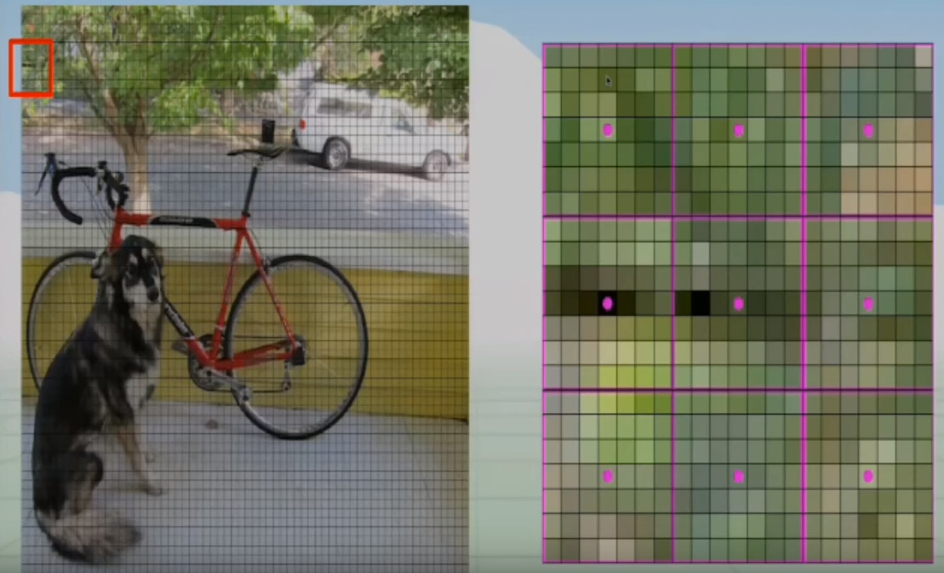



the solution to this problem was given as follows:

<h3>Box filter</h3>

We take the average of all the pixels that make up the space to be analyzed, this matrix of pixels is called a kernel, if the matrix is 7 pixels wide and 7 long, it is said to be a 7X7 kernel

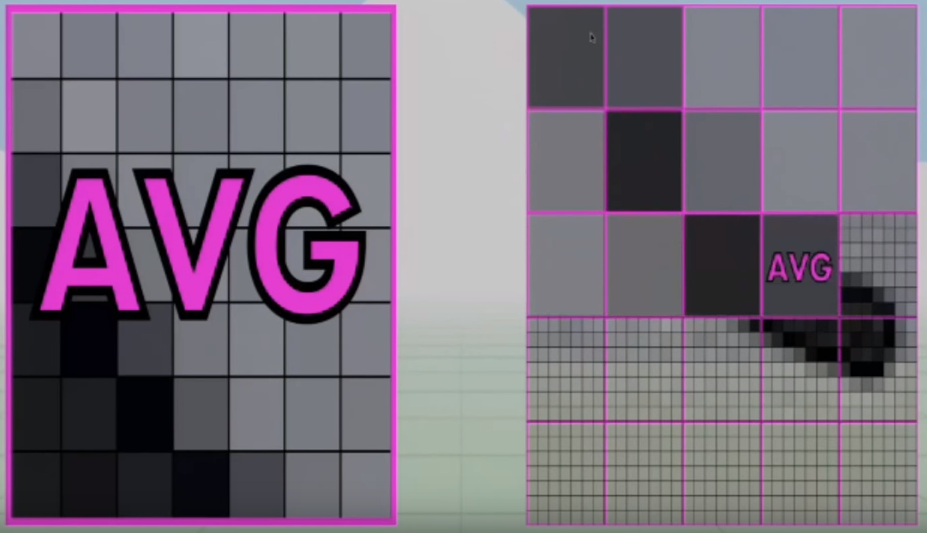



Since the order of the factors does not affect the product, we can apply the kernel to each pixel by converting the image to later see the value of the already averaged point to be re-dimensioned with bilinear interpolation or first see the point and only apply the karnel for said pixel, In both ways, our mathematical operation can be seen as follows:

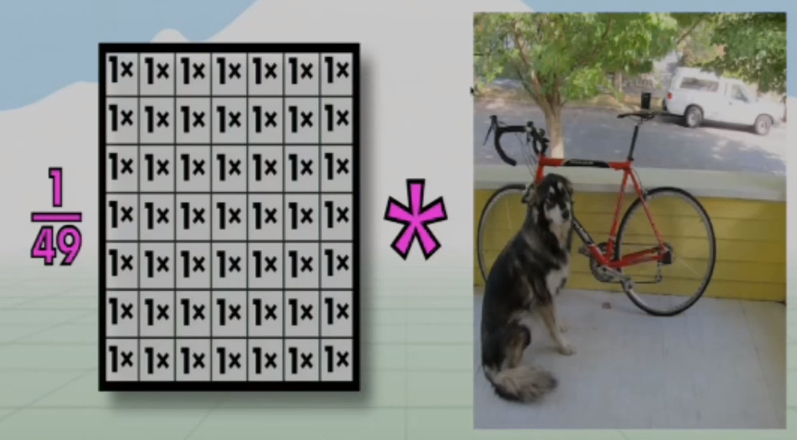



When we apply a 7x7 kernel (a 7x7 matrix that we choose) on each region of our 7x7 pixel image, what we are really doing is a cross correlation, which is only the covariance (it is a value that indicates the degree of variation joint of two random variables with respect to their means)

<img src="Assets/CrossCorrelation.gif">

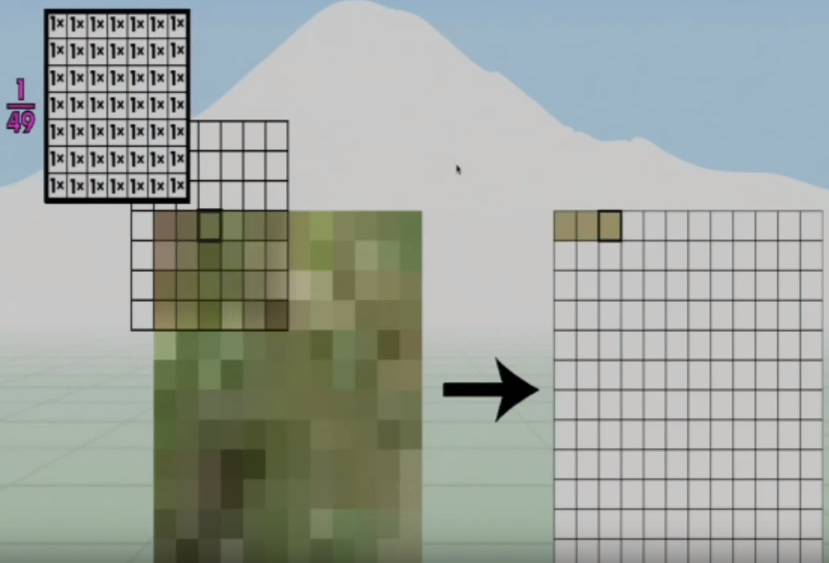



Applying a 7x7 kernel to obtain a value per pixel averaged with its neighbors to create an image of the same resolution but with the new values of each pixel and then scaling them we obtain the following result

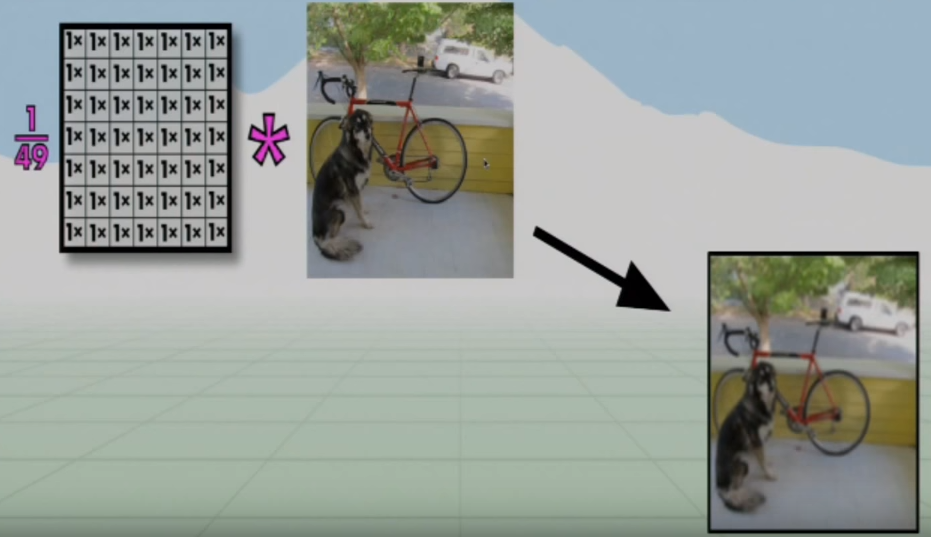



A much better result than we had before, and not only that, we learned to use filters to improve our processes

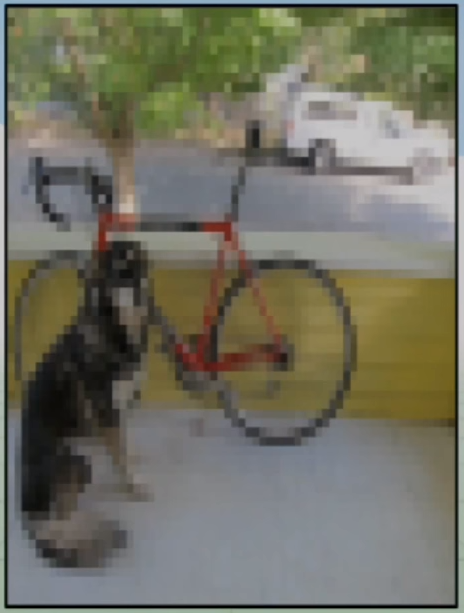



<b>Note</b>: when applying a convolution (we will talk about this later) or a cross correlation in the pixels bordering them, the rest of the matrix is filled with 0 as illustrated in the following image

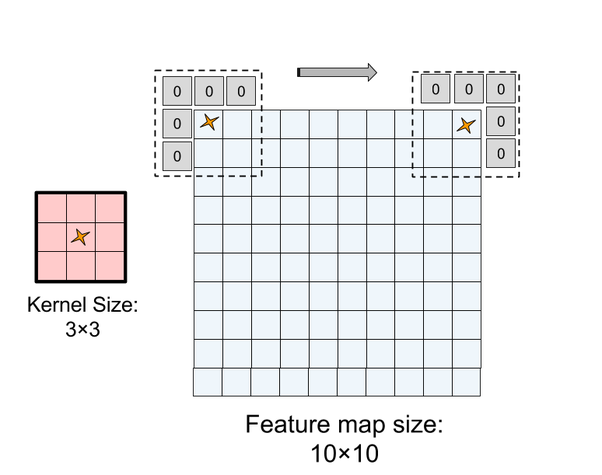



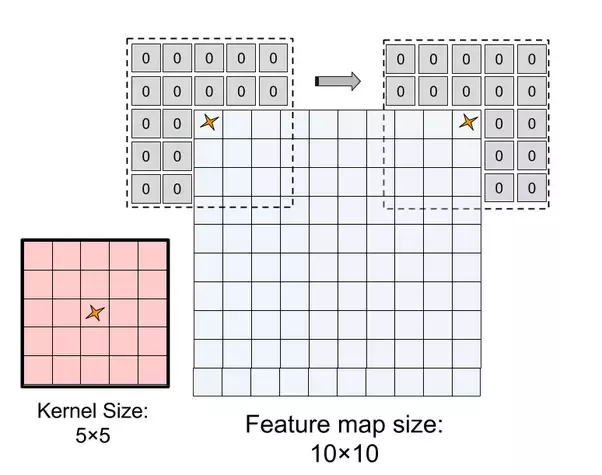



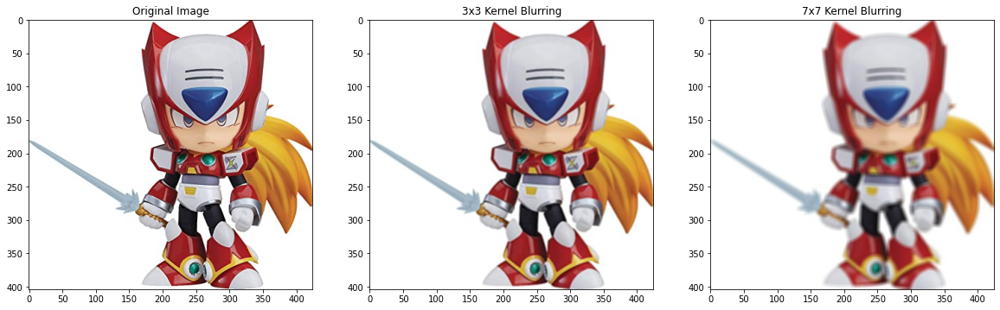

In [11]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

image = cv2.imread('Assets/Zero.jpg')

# Creating our 3 x 3 kernel
kernel_3x3 = np.array([[1, 1, 1],
                       [1, 1, 1],
                       [1, 1, 1]]) / 9

# We use the cv2.fitler2D to conovlve/cross-correlate the kernal with an image 
blurred = cv2.filter2D(image, -1, kernel_3x3)

# Creating our 7 x 7 kernel (another way to create our matrix of ones)
kernel_7x7 = np.ones((7, 7), np.float32) / 49

# the first argument is the image, the second the depth (if we use -1 it takes the same from the original image 
# ('Depth' is type of data of your image. Most used type is unsigned char but other data types may be used (signed char, unsigned short, signed short, int, float, double))
# and the kernel
blurred2 = cv2.filter2D(image, -1, kernel_7x7)

fig, axs = plt.subplots(1,3, figsize=(20, 10))
axs[0].set_title('Original Image')
axs[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
axs[1].set_title('3x3 Kernel Blurring')
axs[1].imshow(cv2.cvtColor(blurred, cv2.COLOR_BGR2RGB))
axs[2].set_title('7x7 Kernel Blurring')
axs[2].imshow(cv2.cvtColor(blurred2, cv2.COLOR_BGR2RGB))
plt.show()

But this filter has a problem, since for each value in the kernel it gives it the same weight, when we have vertical lines they are usually deleted since their value is very small within the other predominant colors that surround the line

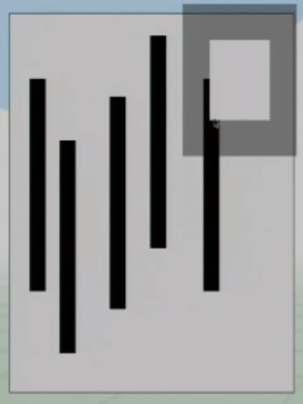



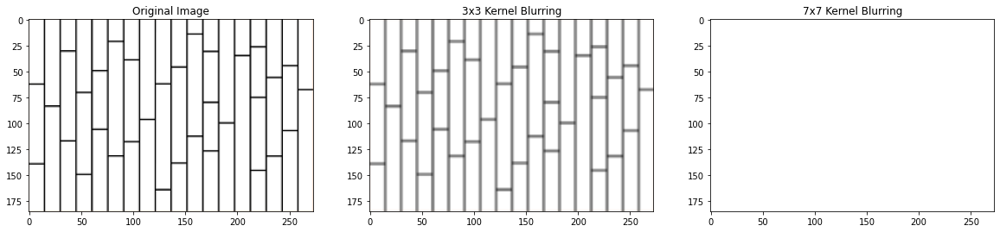

In [8]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

image = cv2.imread('Assets/lines.png')

# Creating our 3 x 3 kernel
kernel_3x3 = np.ones((3, 3), np.float32) / 9

# We use the cv2.fitler2D to conovlve the kernal with an image 
blurred = cv2.filter2D(image, -1, kernel_3x3)

# Creating our 7 x 7 kernel
kernel_7x7 = np.ones((14, 14), np.float32) / 49

blurred2 = cv2.filter2D(image, -1, kernel_7x7)

fig, axs = plt.subplots(1,3, figsize=(20, 10))
axs[0].set_title('Original Image')
axs[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
axs[1].set_title('3x3 Kernel Blurring')
axs[1].imshow(cv2.cvtColor(blurred, cv2.COLOR_BGR2RGB))
axs[2].set_title('14x14 Kernel Blurring')
axs[2].imshow(cv2.cvtColor(blurred2, cv2.COLOR_BGR2RGB))
plt.show()

To solve this we need a new solution

<h3>Gaussean filter</h3>

<b>Gauss's theorem </b> is a theorem which relates the flux of a vector field through a closed surface to the divergence of the field in the volume enclosed. These fields are those whose intensity decreases as the distance to the source squared

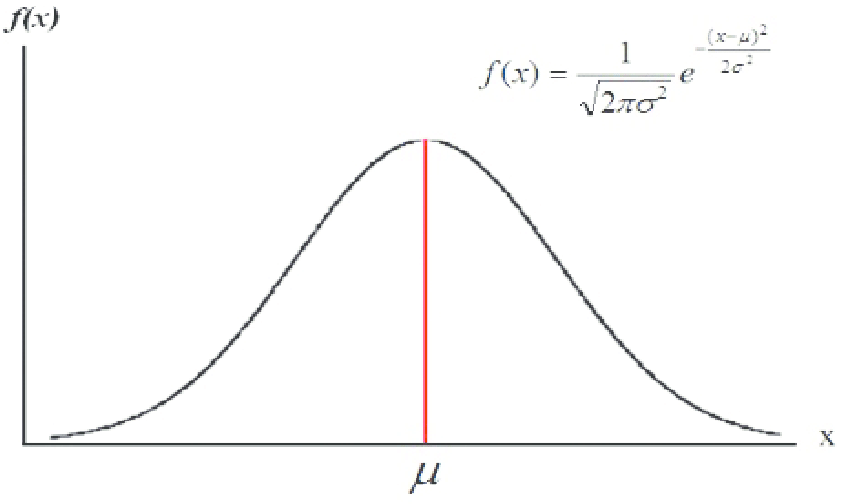



Although originally this equation is for electrostatic fields, it gives us an equation in which the central point is always greater than the rest of the points

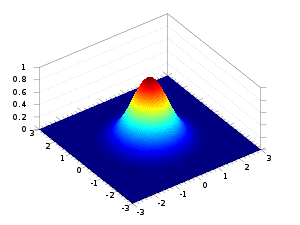



The Gaussian equation applied in three dimensions looks like the figure above, and knowing that in order to represent the weight of the values they decrease through the square of the distance, we can apply it in a kernel in this way

We always need to normalize the filters when looking for an average, Normalization is defined as the division of each element in the kernel by the sum of all kernel elements, so that the sum of the elements of a normalized kernel is unity. This will ensure the average pixel in the modified image is as bright as the average pixel in the original image <i>(some kernels do this normalization embedded in the kernel itself using negative values)</i>

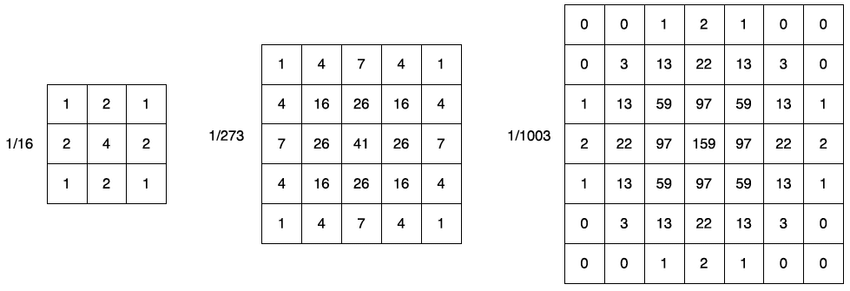



This kernel gives a weight of importance to each pixel depending on its proximity and avoids errors such as lines being erased, still having the same result of blurring the image as the previous kernel

You can see an implementation of this filter from scratch here: https://medium.com/@akumar5/computer-vision-gaussian-filter-from-scratch-b485837b6e09

<h4>With OpenCV</h4>

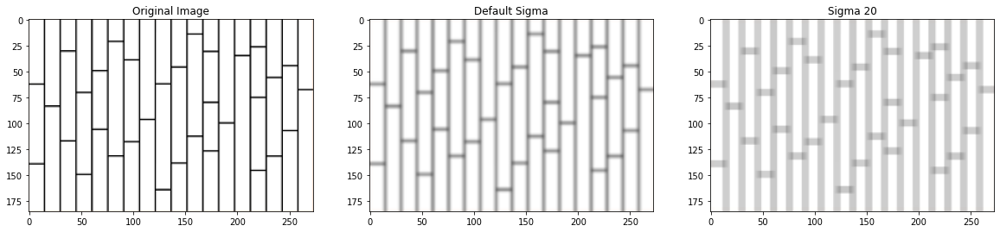

In [15]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

image = cv2.imread('Assets/lines.png')
<h4>With OpenCV</h4>
DefaultSigma = cv2.GaussianBlur(image,(7,7),0)
Sigma20 = cv2.GaussianBlur(image,(7,7),20)

fig, axs = plt.subplots(1,3, figsize=(20, 10))
axs[0].set_title('Original Image')
axs[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
axs[1].set_title('Default Sigma')
axs[1].imshow(cv2.cvtColor(DefaultSigma, cv2.COLOR_BGR2RGB))
axs[2].set_title('Sigma 20')
axs[2].imshow(cv2.cvtColor(Sigma20, cv2.COLOR_BGR2RGB))
plt.show()

<ul style="font-weight: 100;">
    <li><b>The arguments are:</b>
        <ul>
            <li>1: Image</li>
            <li>2: Gaussian kernel size. ksize.width and ksize.height can differ but they both must be positive and odd. Or, they can be zero's and then they are computed from sigma.</li>
            <li>3: Gaussian kernel standard deviation in X direction.</li>
            <li>4: Gaussian kernel standard deviation in Y direction; if sigmaY is zero, it is set to be equal to sigmaX, if both sigmas are zeros, they are computed from ksize.width and ksize.height, respectively</li>
        </ul>
    </li>
</ul>

A low standard deviation indicates that most of the data in a sample tends to be clustered close to its mean (also called the expected value), while a high standard deviation indicates that the data is spread out over a wider range of values. .

<h2>Filters for Images on OpenCV (summary and some others)</h2>

<b>Homogeneous filter (Box filter)</b>: is the most simple filter, each output pixel is the mean of its kernel neighbors (remove sharpening edges)

$$K=\frac{1}{K_{width}K_{height}}\begin{bmatrix} 1 & 1 & 1 & 1 & 1 \\ 1 & 1 & 1 & 1 & 1 \\ 1 & 1 & 1 & 1 & 1 \\ 1 & 1 & 1 & 1 & 1 \\ 1 & 1 & 1 & 1 & 1 \end{bmatrix}$$

<b>Blur filter</b>:Image blurring is achieved by convolving the image with a low-pass filter kernel. It is useful for removing noises. It actually removes high frequency content (eg: noise, edges) from the image. So edges are blurred a little bit in this operation. 

<b>Gaussian filter</b>: is nothing but using different weight kernel, in both x and y direction, 
decreasing from the center outward (reduce the high frequency noise from the image)

$$K=\frac{1}{16}\begin{bmatrix} 1 & 4 & 6 & 4 & 1 \\ 4 & 16 & 24 & 16 & 4 \\ 6 & 24 & 36 & 24 & 6 \\ 4 & 16 & 24 & 16 & 4 \\ 1 & 4 & 6 & 4 & 1 \end{bmatrix}$$

<b>Median filter</b>: is something that replace each pixel's value (central element of the block) with the median of its neighboring pixels. this method is great when dealing with "salt and pepper noise"

<b>Bilateral filter</b>: Bilateral filter also takes a gaussian filter in space, but one more gaussian filter which is a function of pixel difference. Gaussian function of space make sure only nearby pixels are considered for blurring while gaussian function of intensity difference make sure only those pixels with similar intensity to central pixel is considered for blurring. So it preserves the edges since pixels at edges will have large intensity variation.

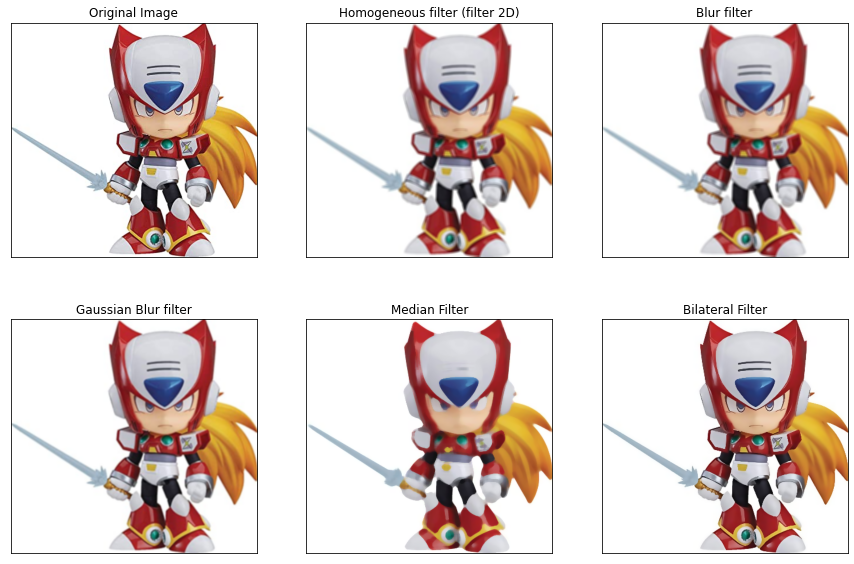

In [27]:
import numpy as np
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = [15, 10]

img = cv2.imread('Assets/Zero.jpg')

#as you remember matplot reads the images in RGB format so instead of converting each one when we are going to plot it we can convert the initial image
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

homogeneousKernel = np.ones((5,5),np.float32)/25 
homogeneousImage = cv2.filter2D(img, -1, homogeneousKernel)

# the first argument is the image, the second the kernel in this case 5 * 5
blurImage = cv2.blur(img,(5,5))

gaussianImage = cv2.GaussianBlur(img, (5,5), 0)

# the first argument is the image, the second is the kernel which in this case has to be proportional (same length and width) so only one side of the kernel is given and it has to be an odd number other than one ( 3,5,7,9, etc ..)
medianFilter = cv2.medianBlur(img, 9)

#the first argument is the image the second is the proportional kernel the third is sigmaColor and the 4 is sigmaspace
bilateralFilter = cv2.bilateralFilter(img,9, 75,75)

titles = ['Original Image','Homogeneous filter (filter 2D)', 'Blur filter', 'Gaussian Blur filter','Median Filter', 'Bilateral Filter']
images = [img, homogeneousImage, blurImage, gaussianImage, medianFilter, bilateralFilter ]
for i in range(len(titles)):
    plt.subplot(2,3,i+1),plt.imshow(images[i])
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([]) 
plt.show()

<i>'Depth' is type of data of your image. Most used type is unsigned char but other data types may be used (signed char, unsigned short, signed short, int, float, double).

'Type' is combination of two separate values into one: 'depth' of image and number of channels in image. So when you provide 'type' of image to some function you actaully provide both 'depth' and number of channels.
<br><br>
sigmaColor – Filter sigma in the color space. A larger value of the parameter means that farther colors within the pixel neighborhood (see sigmaSpace ) will be mixed together, resulting in larger areas of semi-equal color.
<br><br>
sigmaSpace – Filter sigma in the coordinate space. A larger value of the parameter means that farther pixels will influence each other as long as their colors are close enough (see sigmaColor ). When d>0 , it specifies the neighborhood size regardless of sigmaSpace . Otherwise, d is proportional to sigmaSpace .

</i>

A slightly different approach but worth looking into before moving on to the next topic is:

## Image De-noising - Non-Local Means Denoising

The method is based on a simple principle: replacing the color of a pixel with an average of the colors of similar pixels. But the most similar pixels to a given pixel have no reason to be close at all. It is therefore licit to scan a vast portion of the image in search of all the pixels that really resemble the pixel one wants to denoise

Unlike "local mean" filters, which take the mean value of a group of pixels surrounding a target pixel to smooth the image, non-local means filtering takes a mean of all pixels in the image, weighted by how similar these pixels are to the target pixel. This results in much greater post-filtering clarity, and less loss of detail in the image compared with local mean algorithms.

Parameters
- <b>src</b>	Input 8-bit 1-channel, 2-channel or 3-channel image.
- <b>dst</b>	Output image with the same size and type as src .
- <b>h</b>	Parameter regulating filter strength. Big h value perfectly removes noise but also removes image details, smaller h value preserves details but also preserves some noise
- <b>search_window</b>	Size in pixels of the window that is used to compute weighted average for given pixel. Should be odd. Affect performance linearly: greater search_window - greater denoising time. Recommended value 21 pixels
- <b>block_size</b>	Size in pixels of the template patch that is used to compute weights. Should be odd. Recommended value 7 pixels
- <b>stream</b>	Stream for the asynchronous invocations.

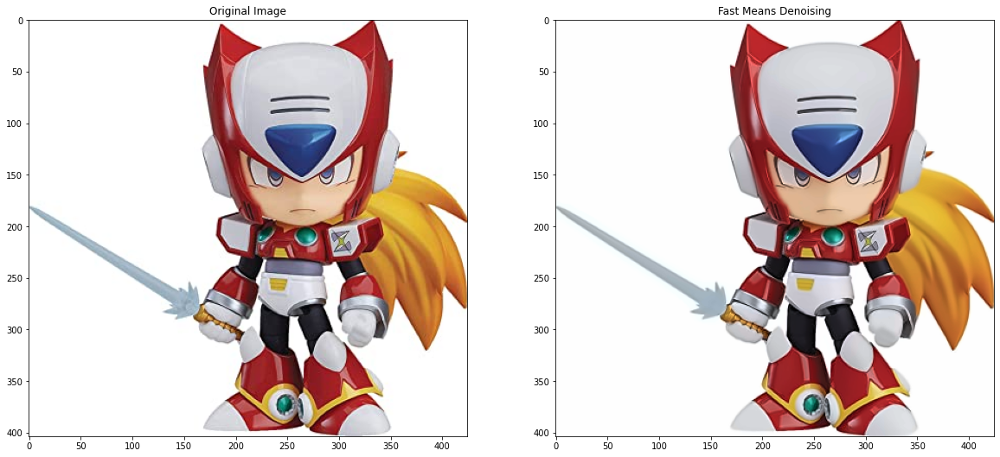

In [4]:
import numpy as np
import cv2

image = cv2.imread('Assets/Zero.jpg')

dst = cv2.fastNlMeansDenoisingColored(image, None, 6, 6, 7, 21)

fig, axs = plt.subplots(1,2, figsize=(20, 10))
axs[0].set_title('Original Image')
axs[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
axs[1].set_title('Fast Means Denoising')
axs[1].imshow(cv2.cvtColor(dst, cv2.COLOR_BGR2RGB))

plt.show()

**There are 4 variations of Non-Local Means Denoising:**

- cv2.fastNlMeansDenoising() - works with a single grayscale images
- cv2.fastNlMeansDenoisingColored() - works with a color image.
- cv2.fastNlMeansDenoisingMulti() - works with image sequence captured in short period of time (grayscale images)
- cv2.fastNlMeansDenoisingColoredMulti() - same as above, but for color images.

<h2>Low-pass/High-pass Filters</h2>

In one-dimensional signals, images also can be filtered with various low-pass filters(LPF) and high-pass filters(HPF).<br><br>
<b>Low-pass filters(LPF)</b>:helps in removing noises, blurring the images.<br>
<b>High-pass filters(HPF)</b>:filters helps in finding edges in the images.

<h3>Simple Image Thresholding (With Global Value)</h3>

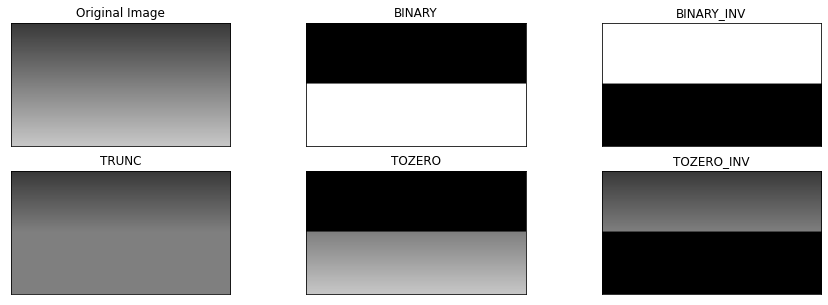

In [25]:
import numpy as np
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = [15, 5]

img = cv2.imread('Assets/gradient.jpg')
# the first argument is the image, the second is the minimum value, the third is the maximum value and the 4 is the type of threshold
ret,thresh1 = cv2.threshold(img,127,255,cv2.THRESH_BINARY) # if the value is between the numbers it is 1 (white) if it is not 0 (black)
ret,thresh2 = cv2.threshold(img,127,255,cv2.THRESH_BINARY_INV) # if the value is between the numbers it is 0 (black) if it is not 1 (white)
ret,thresh3 = cv2.threshold(img,127,255,cv2.THRESH_TRUNC) # if the value is between the numbers makes it the minimum value (in this case 127)
ret,thresh4 = cv2.threshold(img,127,255,cv2.THRESH_TOZERO) # if the value is not in the numbers it converts it to 0 (black)
ret,thresh5 = cv2.threshold(img,127,255,cv2.THRESH_TOZERO_INV) # if the value is in the numbers it converts it to 0 (black)

titles = ['Original Image','BINARY', 'BINARY_INV', 'TRUNC','TOZERO', 'TOZERO_INV']
images = [img, thresh1, thresh2, thresh3, thresh4, thresh5 ]
for i in range(len(titles)):
    plt.subplot(2,3,i+1),plt.imshow(images[i])
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([]) 
plt.show()

<h2>Adaptive Thresholding (With Dynamic Value)</h2>

In the previous section, we used a global value as threshold value. But it may not be good in all the conditions where image has different lighting conditions in different areas. In that case, we go for adaptive thresholding. In this, the algorithm calculate the threshold for a small regions of the image. So we get different thresholds for different regions of the same image and it gives us better results for images with varying illumination.

The threshold value <b>T(x,y)</b> is a mean of the <b>blockSize x blockSize</b> neighborhood of <b>(x,y)</b> minus <b>C</b><br>
The threshold value <b>T(x,y)</b> is a a weighted sum(cross-correlation with a Gaussian window) of the <b>blockSize x blockSize</b> neighborhood of <b>(x,y)</b> minus <b>C</b><br> <i>the default sigma (standard deriviation) is used for the specified blockSize (see getGaussianKernel)</i>

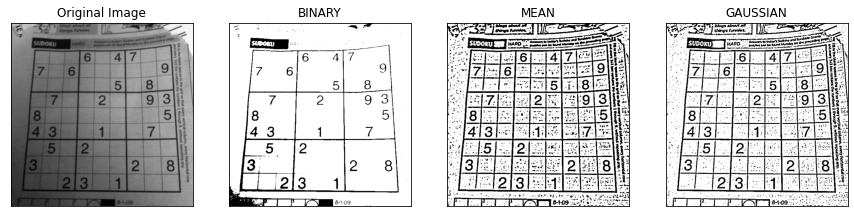

In [22]:
import numpy as np
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = [15, 30]

img = cv2.imread('Assets/sudoku.png',0)

ret,th1 = cv2.threshold(img,50,255,cv2.THRESH_BINARY) 

# It's good practice to blur images as it removes noise
img = cv2.GaussianBlur(img, (3, 3), 0)

# the first argument is the image the second the maximum value that the third the filter type can have
# (Mean or Gaussian) 4 is the type of threshold, 5 is the size of the block (in this case 11 * 11 pixels) and 6 is the constant (c) that is subtracted from the calculated mean
th2 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_MEAN_C,cv2.THRESH_BINARY,11,2)
th3 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,cv2.THRESH_BINARY,11,2)

titles = ['Original Image','BINARY', 'MEAN', 'GAUSSIAN']
images = [img, th1, th2, th3 ]
for i in range(len(titles)):
    plt.subplot(1,4,i+1),plt.imshow(images[i], cmap='gray')
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([]) 
plt.show()

<h2>Otsu's Binarization</h2>

In global thresholding, we used an arbitrary chosen value as a threshold. In contrast, Otsu's method avoids having to choose a value and determines it automatically.

Consider an image with only two distinct image values (bimodal image), where the histogram would only consist of two peaks. A good threshold would be in the middle of those two values. Similarly, Otsu's method determines an optimal global threshold value from the image histogram.

In order to do so, the <b>cv.threshold()</b> function is used, where <b>cv.THRESH_OTSU</b> is passed as an extra flag. The threshold value can be chosen arbitrary. The algorithm then finds the optimal threshold value which is returned as the first output.

Check out the example below. The input image is a noisy image. In the first case, global thresholding with a value of 127 is applied. In the second case, Otsu's thresholding is applied directly. In the third case, the image is first filtered with a 5x5 gaussian kernel to remove the noise, then Otsu thresholding is applied. See how noise filtering improves the result.

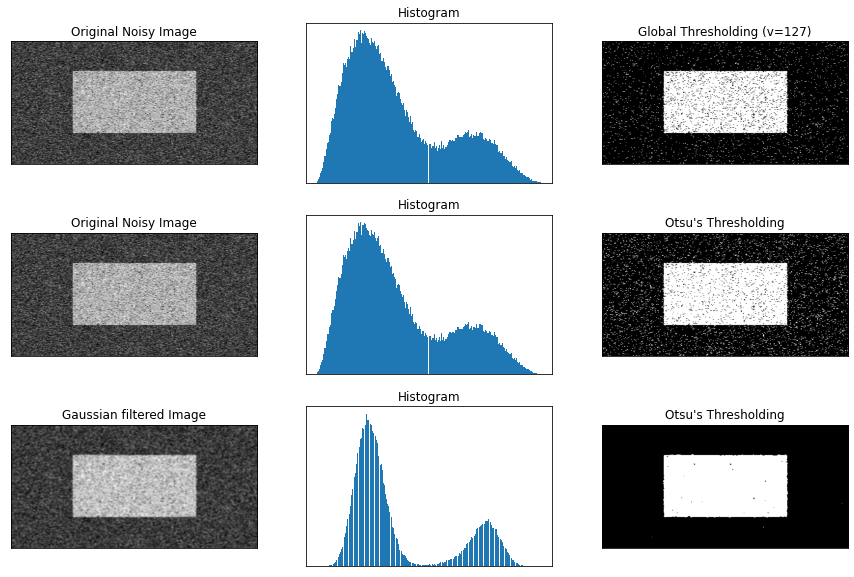

In [52]:
import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = [15, 10]

img = cv.imread('Assets/noisy2.png',0)

# global thresholding
ret1,th1 = cv.threshold(img,127,255,cv.THRESH_BINARY)

# Otsu's thresholding
ret2,th2 = cv.threshold(img,0,255,cv.THRESH_BINARY+cv.THRESH_OTSU)

# Otsu's thresholding after Gaussian filtering
blur = cv.GaussianBlur(img,(5,5),0)
ret3,th3 = cv.threshold(blur,0,255,cv.THRESH_BINARY+cv.THRESH_OTSU)

# plot all the images and their histograms
images = [img, 0, th1,
          img, 0, th2,
          blur, 0, th3]
titles = ['Original Noisy Image','Histogram','Global Thresholding (v=127)',
          'Original Noisy Image','Histogram',"Otsu's Thresholding",
          'Gaussian filtered Image','Histogram',"Otsu's Thresholding"]
for i in range(3):
    plt.subplot(3,3,i*3+1),plt.imshow(images[i*3],'gray')
    plt.title(titles[i*3]), plt.xticks([]), plt.yticks([]) # labels in 'X' and 'Y' empty
    
    plt.subplot(3,3,i*3+2),plt.hist(images[i*3].ravel(),256) 
    plt.title(titles[i*3+1]), plt.xticks([]), plt.yticks([]) #  we plot a histogram (I'll explain it below)
    
    plt.subplot(3,3,i*3+3),plt.imshow(images[i*3+2],'gray')
    plt.title(titles[i*3+2]), plt.xticks([]), plt.yticks([])
plt.show()

Since we have just used a histogram, it is a good time to explain it, then we will continue talking about binary operations

<h2>Histograms</h2>

<b>One-dimensional</b>

Is an approximate representation of the distribution of numerical data. but in an image processing context, the histogram of an image normally refers to a histogram of the pixel intensity values. This histogram is a graph showing the number of pixels in an image at each different intensity value found in that image.

One of the more common use is to decide what value of threshold to use when converting a grayscale image to a binary one by thresholding. If the image is suitable for thresholding then the histogram will be bi-modal. the pixel intensities will be clustered around two well-separated values. A suitable threshold for separating these two groups will be found somewhere in between the two peaks in the histogram. If the distribution is not like this then it is unlikely that a good segmentation can be produced by thresholding.

To construct a histogram, the first step is to "bin" (or "bucket") the range of values—that is, divide the entire range of values into a series of intervals—and then count how many values fall into each interval. The bins are usually specified as consecutive, non-overlapping intervals of a variable. 

<i><b>Data binning</b> (also called Discrete binning or bucketing) is a data pre-processing technique used to reduce the effects of minor observation errors. The original data values which fall into a given small interval, a bin, are replaced by a value representative of that interval, often the central value. It is a form of quantization. (a way to group numbers of more or less continuous values into a smaller number) </i>

The matplot histogram (<b>plt.hist()</b>) takes a lot of arguments, but the most important ones are the first which is the matrix of values of one dimension, the second which are the bins, (in this case from 0 to 265 in different bins ( if you want to specify a bins renges, you can do it as [0,10,50,200,256])) and the third is the range of values that we are introducing.

you can see all the arguments in the documentation: https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.hist.html

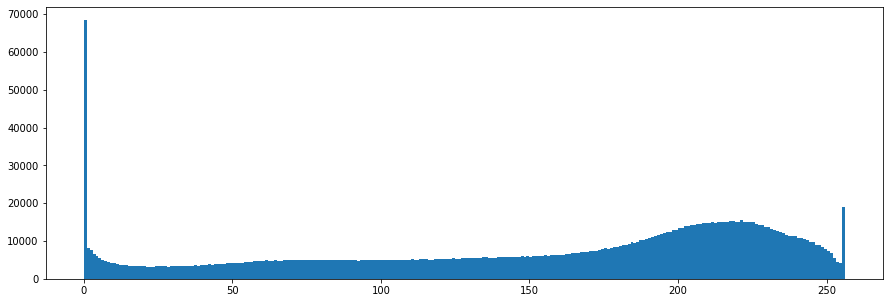

In [48]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = [15, 5]

image = cv2.imread('Assets/M&M.jpg')

# We plot a histogram, ravel() flatens our image array 
plt.hist(image.ravel(), 256, [0, 256]);
plt.show()

The <b>ravel()</b> function is used to create a contiguous flattened array.

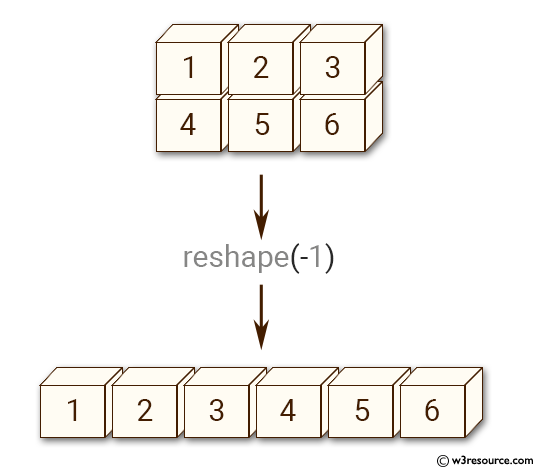



<b>Multidimensional</b>

the OpenCV Historgram (<b>calcHist()</b>) take as argumens the Image, the index of channel for which we calculate histogram. For example, if input is grayscale image, its value is [0]. For color image, you can pass [0], [1] or [2] to calculate histogram of blue, green or red channel respectively, a mask image. To find histogram of full image, it is given as "None", the bins and the range

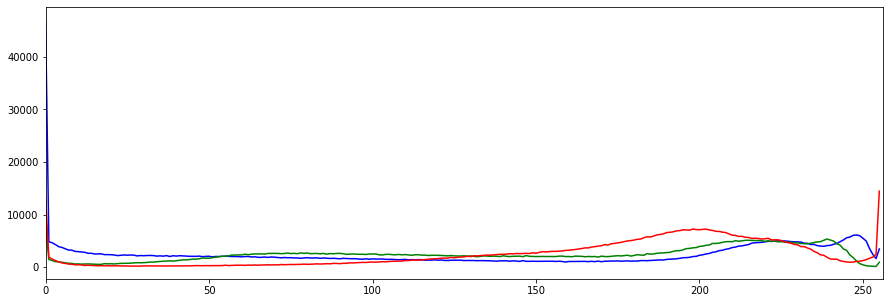

In [43]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = [15, 5]

image = cv2.imread('Assets/M&M.jpg')

# Viewing Separate Color Channels
color = ('b', 'g', 'r')

# We now separate the colors and plot each in the Histogram
for i, col in enumerate(color):
    histogram = cv2.calcHist([image], [i], None, [256], [0, 256])
    plt.plot(histogram, color = col)
    plt.xlim([0,256])
    
plt.show()

<h2>Morphological Transformations</h2>

Morphological transformations are some simple operations base on the image shape.
morphological transformations are normally performed on binary images.
when you perform a morphological transformation you need to things, the image and a structuring element (a Kernel).
a Kernel tells you how to change the value of any given pixel by combining it with different amounts of the neighboring pixels.

['MORPH_BLACKHAT', 'MORPH_CLOSE', 'MORPH_CROSS', 'MORPH_DILATE', 'MORPH_ELLIPSE', 'MORPH_ERODE', 'MORPH_GRADIENT', 'MORPH_HITMISS', 'MORPH_OPEN', 'MORPH_RECT', 'MORPH_TOPHAT']


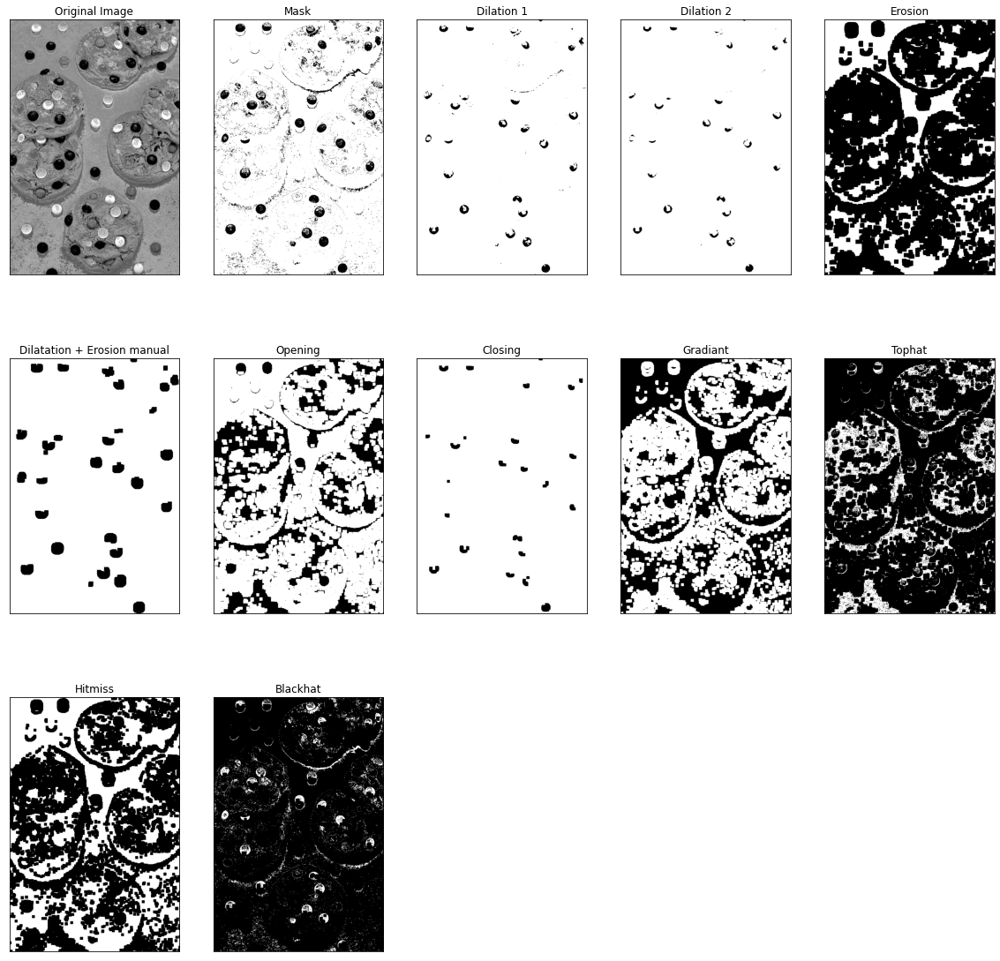

In [38]:
import numpy as np
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = [20, 20]

img = cv2.imread('Assets/M&M.jpg')
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

#ideal values for blue
l_b = np.array([88,134,0])
u_b = np.array([113,255,355]) 

# we define a mask the first argument is the image you want to mask, the second the lower limit and the third the upper limit
maskRange= cv2.inRange(hsv, l_b, u_b)

# we mix the image with itself but with a mask the third argument is the mask
res = cv2.bitwise_and(img,img,mask=maskRange)

#we load the image in grayscale (you can't go from hsv to gray directly)
img = cv2.cvtColor(img, cv2.COLOR_HSV2BGR)
img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# we pass the values to black and white with a filter
ret, mask = cv2.threshold(img,170,255,cv2.THRESH_BINARY_INV)

#define a kernel, the first argument is the kernel length (the width of the box, the length of the box)
kernal = np.ones((2,2), np.uint8)

# we apply a dilation filter (with a pixel within the frame being 1, the entire iteration frame becomes ones)
#the first argument is the boolean image, the second is the kernal and the third is the number of times the operation will be done once it is finished on the same image
dilation = cv2.dilate(mask, kernal, iterations = 3 )

kernel2 = np.ones((6,6), np.uint8)
dilation2 = cv2.dilate(mask, kernel2, iterations = 1 )

# to further separate the separated ones and eliminate floating pixels it is better to increase the size of the kernal
# to fill in figures it is better to increase the iterations

# erode: if any pixel inside the kernel is 0 all karnel becomes 0
erosion = cv2.erode(mask, kernel2, iterations = 3 ) 
erosion2 = cv2.erode(dilation2, kernel2, iterations = 3 )

#morphologyEx are more morphological filters (expressions) the first argument is the image, the second the filter, the third the kernal and the 4 the iterations

# opening is erosion followed by dilation.
opening = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel2, iterations = 2 )

# closeing is dilation followed by erosion.
closing = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel2, iterations = 2 )

# It is the difference between dilation and erosion of an image.
gradiant = cv2.morphologyEx(mask, cv2.MORPH_GRADIENT, kernel2, iterations = 2 )

# It is the difference between input image and Opening of the image.
tophat = cv2.morphologyEx(mask, cv2.MORPH_TOPHAT, kernel2, iterations = 2 )

# It is the difference between the closing of the input image and input image.
blackhat = cv2.morphologyEx(mask, cv2.MORPH_BLACKHAT, kernel2, iterations = 2 )

# preserves the binary image pixels whose neighborhoods match the kernel shape.
hitmiss = cv2.morphologyEx(mask, cv2.MORPH_HITMISS, kernel2, iterations = 2 )


morphologyEx =[i for i in dir(cv2) if 'MORPH' in i] # we iterate using List Comprehensions all OpenCV morphological expressions and return only those that contain EVENT in the text
print(morphologyEx)

titles = ['Original Image','Mask', 'Dilation 1', 'Dilation 2', 'Erosion', 'Dilatation + Erosion manual','Opening', 'Closing', 'Gradiant', 'Tophat','Hitmiss', 'Blackhat']
images = [img, mask, dilation, dilation2, erosion, erosion2, opening, closing, gradiant, tophat, hitmiss, blackhat]
for i in range(len(titles)):
    plt.subplot(3,5,i+1),plt.imshow(images[i],'gray')
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([]) 
plt.show()

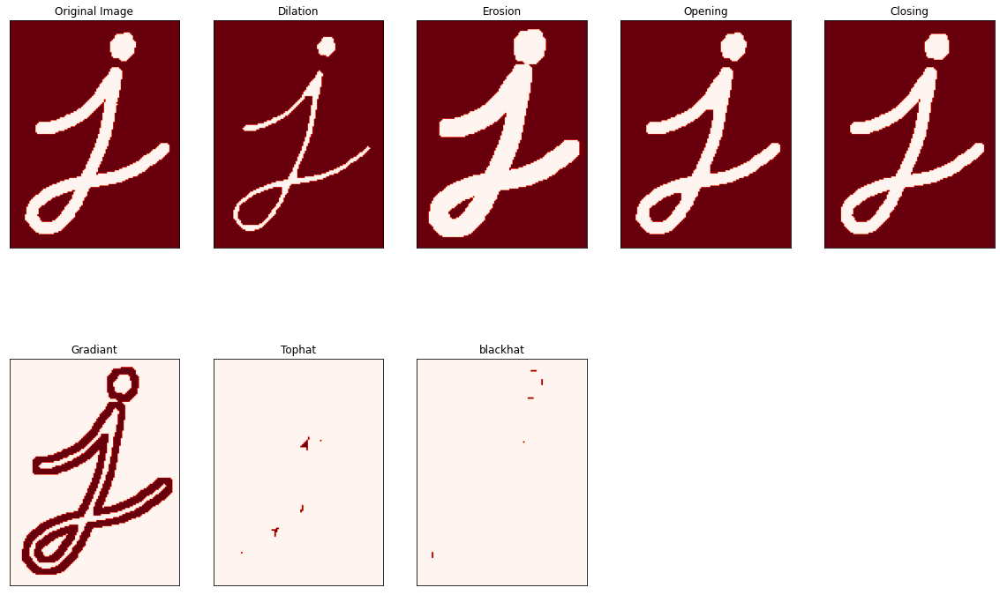

In [39]:
import cv2
import numpy as np

img = cv2.imread('Assets/j.png',0)
kernel = np.ones((5,5),np.uint8)
dilationn = cv2.dilate(img,kernel,iterations = 1)
erosion = cv2.erode(img,kernel,iterations = 1)
opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
tophatt = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, kernel)
blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, kernel)

titles = ['Original Image','Dilation', 'Erosion','Opening', 'Closing', 'Gradiant', 'Tophat','blackhat']
images = [img, dilationn, erosion, opening, closing, gradient, tophatt, blackhat]
for i in range(len(titles)):
    plt.subplot(3,5,i+1),plt.imshow(images[i],'Reds')
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([]) 
plt.show()

We manually created a structuring elements in the previous examples with help of Numpy. It is rectangular shape. But in some cases, you may need elliptical/circular shaped kernels. So for this purpose, OpenCV has a function, <b>cv2.getStructuringElement()</b>. You just pass the shape and size of the kernel, you get the desired kernel.

We can choose any of three shapes for our kernel:
<br><br>
Rectangular box: MORPH_RECT <br>
Cross: MORPH_CROSS<br>
Ellipse: MORPH_ELLIPSE

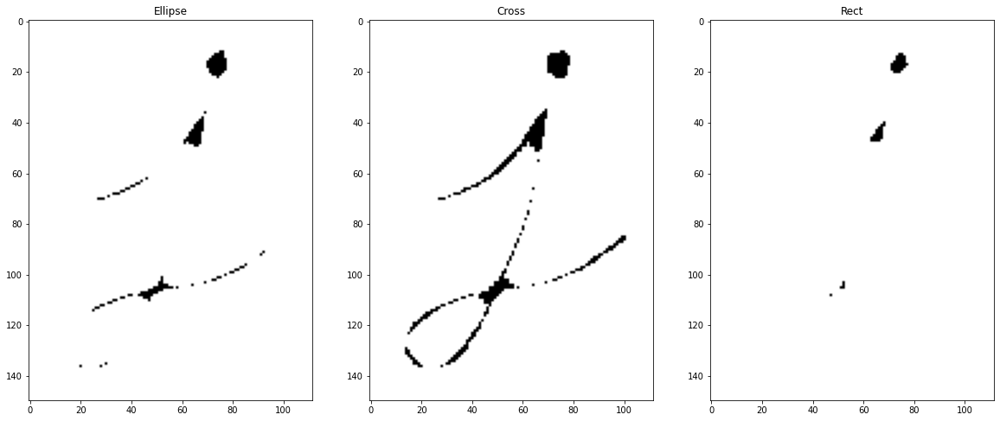

In [53]:
import numpy as np
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = [20, 20]

img = cv2.imread('Assets/j.png')

ellipseKernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5,5))
ellipse = cv2.dilate(img, ellipseKernel, iterations=2)
crossKernel = cv2.getStructuringElement(cv2.MORPH_CROSS, (5,5))
cross = cv2.dilate(img, crossKernel, iterations=2)
rectKernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5,5))
rect = cv2.dilate(img, rectKernel, iterations=2)

fig, axs = plt.subplots(1,3, figsize=(20, 10))
axs[0].set_title('Ellipse')
axs[0].imshow(cv2.cvtColor(ellipse, cv2.COLOR_BGR2RGB))
axs[1].set_title('Cross')
axs[1].imshow(cv2.cvtColor(cross, cv2.COLOR_BGR2RGB))
axs[2].set_title('Rect')
axs[2].imshow(cv2.cvtColor(rect, cv2.COLOR_BGR2RGB))
plt.show()

The shapes look something like:

In [ ]:
# Rectangular Kernel
cv2.getStructuringElement(cv2.MORPH_RECT,(5,5))
array([[1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1]], dtype=uint8)

# Elliptical Kernel
cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5,5))
array([[0, 0, 1, 0, 0],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [0, 0, 1, 0, 0]], dtype=uint8)

# Cross-shaped Kernel
cv2.getStructuringElement(cv2.MORPH_CROSS,(5,5))
array([[0, 0, 1, 0, 0],
       [0, 0, 1, 0, 0],
       [1, 1, 1, 1, 1],
       [0, 0, 1, 0, 0],
       [0, 0, 1, 0, 0]], dtype=uint8)

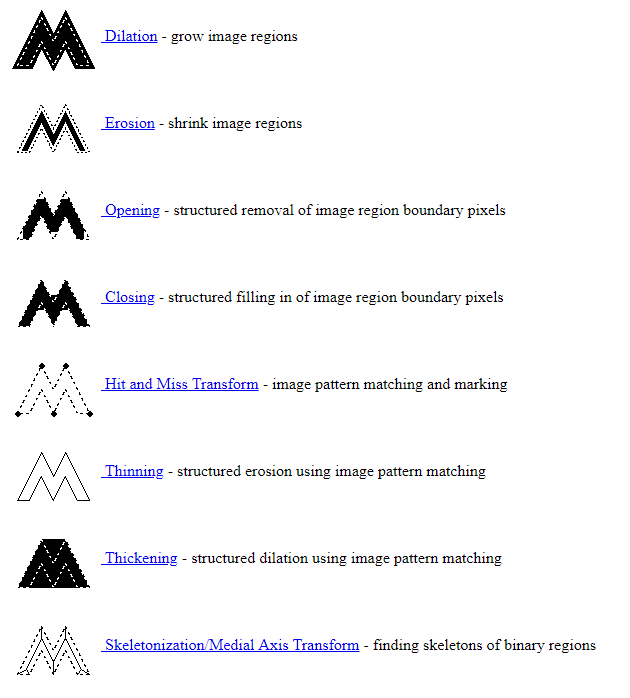

<b>There is no native implementation of the last 3 in python but it can be done with the others</b>

<h3>Skeletonization implementation</h3>

(100, 300)


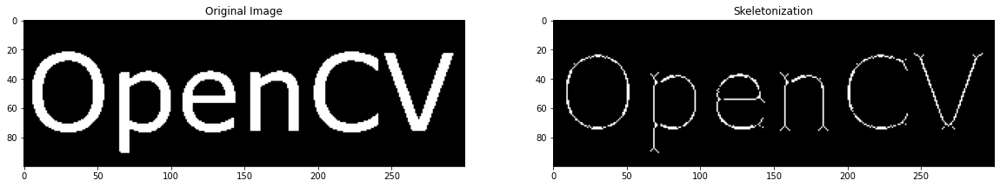

In [2]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = [20, 20]
 
img = cv2.imread('Assets/sofsk.png',0)
showimg = img
size = np.size(img)
print(img.shape)
skel = np.zeros(img.shape,np.uint8)
 
ret,img = cv2.threshold(img,127,255,0)
element = cv2.getStructuringElement(cv2.MORPH_CROSS,(3,3))
done = False
 
while( not done):
    eroded = cv2.erode(img,element)
    temp = cv2.dilate(eroded,element)
    temp = cv2.subtract(img,temp)
    skel = cv2.bitwise_or(skel,temp)
    img = eroded.copy()
 
    zeros = size - cv2.countNonZero(img)
    if zeros==size:
        done = True
        
fig, axs = plt.subplots(1,2, figsize=(20, 10))
axs[0].set_title('Original Image')
axs[0].imshow(showimg, cmap='gray')
axs[1].set_title('Skeletonization')
axs[1].imshow(skel, cmap='gray')
plt.show()

<h2>Bitwise Operations</h2>

A bitwise operation operates on binary numbers at the level of their individual bits. It is a fast primitive action, supported directly by the processors because they are based on the logic gates that make up the processors.

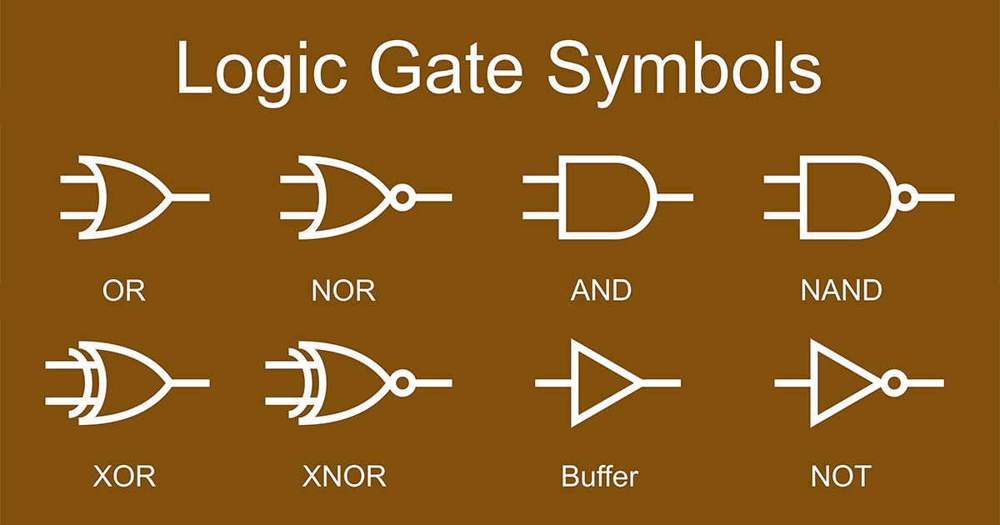



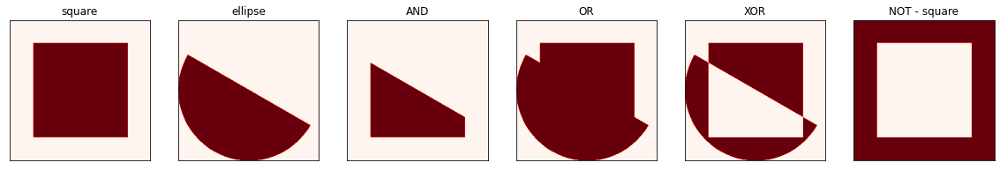

In [5]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = [20, 20]

square = np.zeros((300, 300), np.uint8)
cv2.rectangle(square, (50, 50), (250, 250), 255, -2)

# Making a ellipse
ellipse = np.zeros((300, 300), np.uint8)
cv2.ellipse(ellipse, (150, 150), (150, 150), 30, 0, 180, 255, -1)

# Shows only where they intersect
And = cv2.bitwise_and(square, ellipse)

# Shows where either square or ellipse is 
bitwiseOr = cv2.bitwise_or(square, ellipse)

# Shows where either exist by itself
bitwiseXor = cv2.bitwise_xor(square, ellipse)

# Shows everything that isn't part of the square
bitwiseNot_sq = cv2.bitwise_not(square)

titles = ['square', 'ellipse','AND', 'OR','XOR', 'NOT - square']
images = [square, ellipse, And, bitwiseOr, bitwiseXor, bitwiseNot_sq]
for i in range(len(titles)):
    plt.subplot(1,6,i+1),plt.imshow(images[i],'Reds')
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([]) 
plt.show()

<h3>Find Edges</h3>

Imagine that we want to find the edges in an image, we know that the edges are only the places where there is a quick difference in the values of the image, if we consider that an image is just a linear function of two dimensions, we can find these peaks in the intensity of the curve as its rate of change, that is, the first derivative of the curve will help us find the edges of the image in each of its components

<div style="display: flex;" >
    <div style="width:50%;text-align:center">
    <div style="align-items: center;justify-content: center;display: flex;height: 100%;width: 100%;">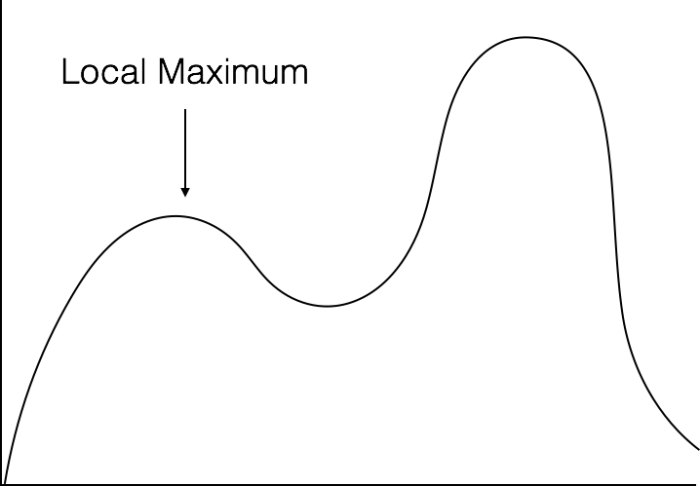</div>    
    </div>
    <div style="width:50%;text-align:center">
    <div style="align-items: center;justify-content: center;display: flex;height: 100%;width: 100%;">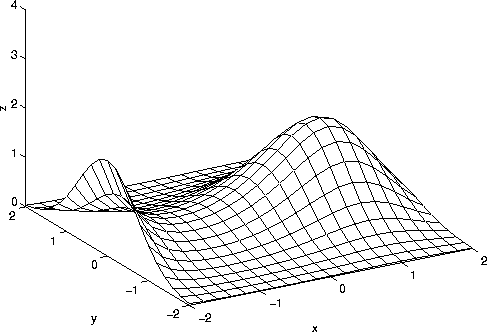</div> 
</div>

The slope (derivative) at each point of a function generates a new function (derived function) that represents the growth, constancy or decrease of the primitive function.

Derivatives are defined as:

\begin{align*}
f'(a) = \lim_{h \to 0} \frac{f(a+h) - f(a)}{h}
\end{align*}

In other words:<br>
a= measurement at one point<br>
h = distance between both measurements<br>
lim of h tends to 0 = when you move tending to 0, we cannot do this in an image so we do it with 1, so we can say that when the limit tends to the smallest unit of movement

With this the equation means that we measure at a point, then at an adjoining point, subtract the values and divide by how much we moved to find the difference between the points

This applied in a kernel would look like this: (for the moment ignore that the values are reversed, it should be 1 and -1, not -1 and 1)

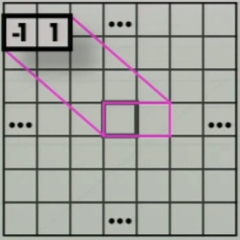



we move one unit in h and we take the difference between the values and divide the result by 1, the only problem is that this would give us the value between the two pixels so what we really need is to convert h to 2 to get the value of a pixel between two pixels

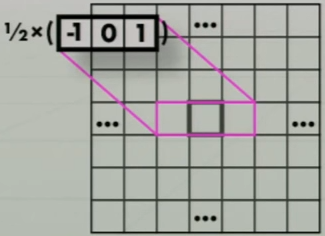



we move 2 units in h and take the difference between the values and divide the result by 2 to obtain the value of the pixel in the center

This method works very well but since many images contain garbage, this algorithm could find borders in places where there are none, because there is a quick difference in the values of the colors

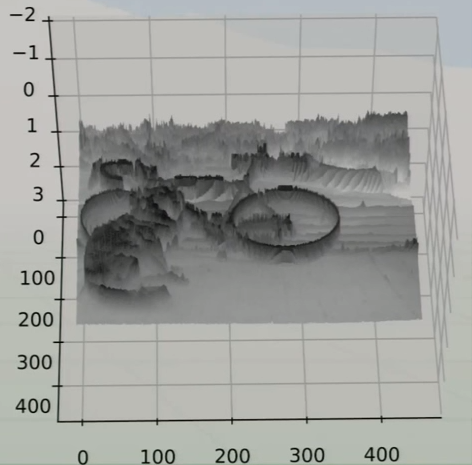



As seen in the previous image, it contains many peaks due to the difference in colors, however to get rid of this problem we already know the solution, we apply a Gaussian filter to convert each pixel into the average of its neighbors and eliminate misplaced colors

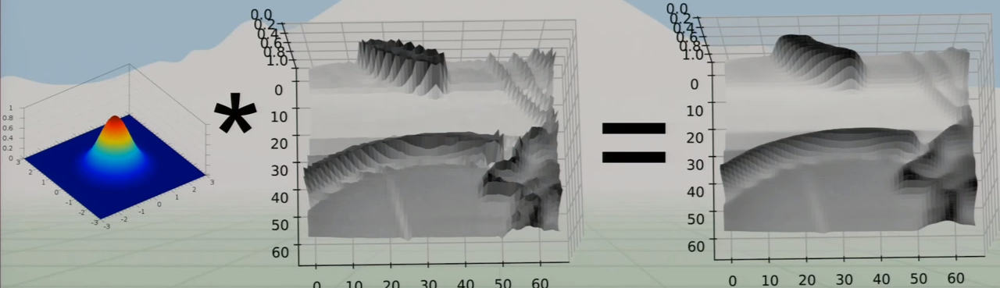



Now we run our other filter and thus we make sure that the edges it finds are really edges, but let's talk about how to mix these filters to achieve the same in a single operation

<h3>Properties of convolutions</h3>

<b>Convolution theorem</b>:states that, under certain circumstances, the Fourier transform of a convolution is the point-to-point product of the transforms. In other words, the convolution in one domain (eg the temporal domain) is equivalent to the point-to-point product in the other domain (ie spectral domain).

For practical purposes it is to say that if we rotate our kernel (which was a crossed correlation) 180 degres then we can make use of the properties of Fourier transforms.

why we can interpret our kernel as a furier transform and why we can apply these transforms in this way will be left out for the moment.

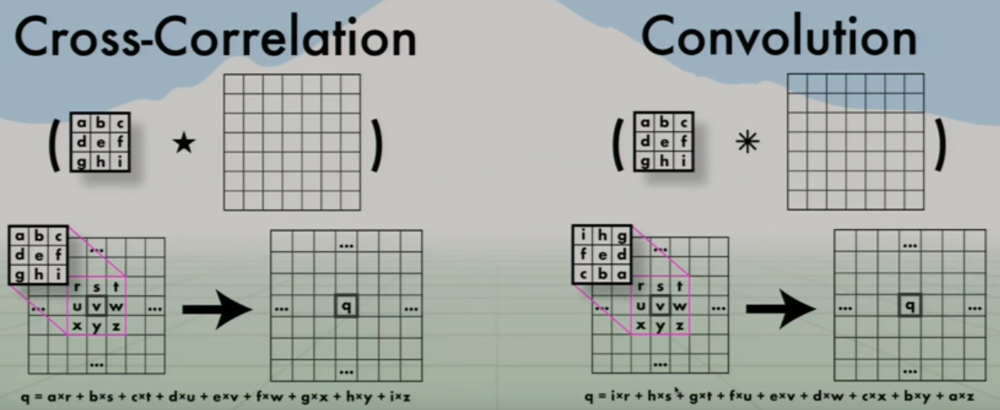



Some of the properties of these transforms are the following:

<b>Commutative property</b>: multiplying the kernel by the image is the same as the image by the kernel

\begin{align*}B*A=A*B\end{align*}

<b>Associative property</b>: it is the same to apply a filter to an image and then another filter than a filter to another and then apply it to the image

\begin{align*}A*(B*C)=(A*B)*C\end{align*}

<b>Distribution property over addition</b>: It is the same to superimpose two images and then convolve them as it is to convolve each one of them and then superimpose them

\begin{align*}A*(B+C)=A*B+A*C\end{align*}

<b>Scalable property</b>: It is the same to multiply a scalar by two images and then add them to multiply the scalar by any of those two images and multiply it by the other

\begin{align*}X(A*B)=(XA)*B=A*(XB)\end{align*}

Thanks to these properties, we can convert our edge filter and the Gaussian filter into a single filter instead of first passing the Gaussian filter and then the edge filter.

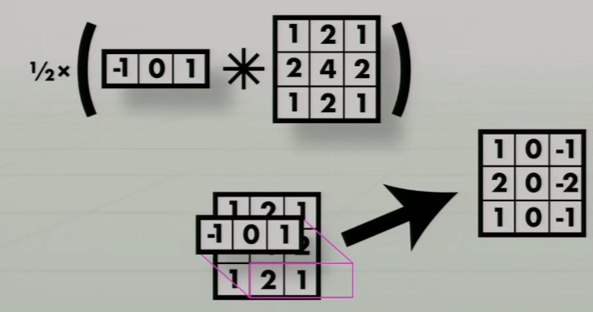



We invert the two filters (which are crossed correlation) to be able to make use of the properties of the convolutions, we multiply them and invert the result again to be able to use it as a kernel.

So we use cross-correlation applying kernels on images for image matching, pattern recognition or image stitching but we apply convolutions for operations between filters

These two filters that we obtained previously are known as <b>Sobel filters</b> and we can get them both for the derivative in 'X' and in 'Y'

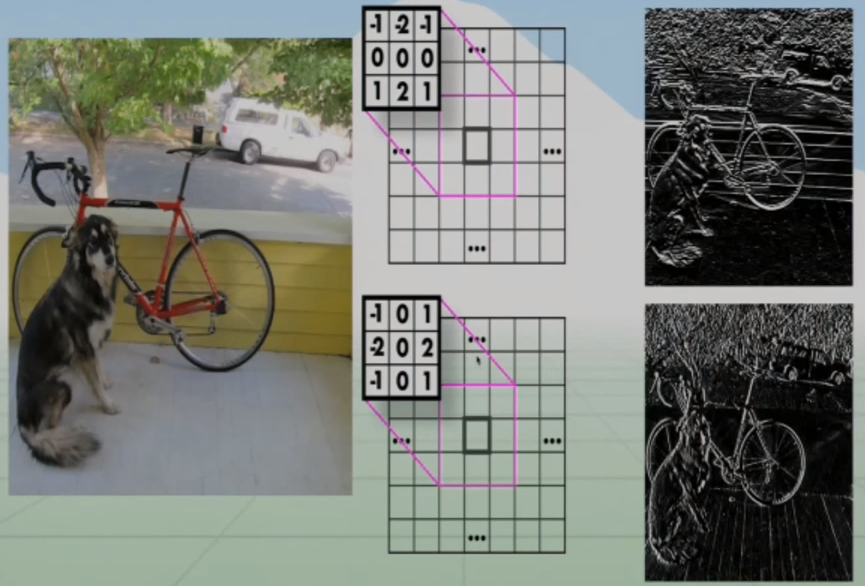



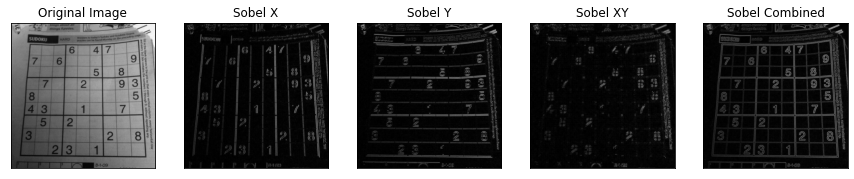

In [18]:
import numpy as np
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = [15, 5]

img = cv2.imread('Assets/sudoku.png', cv2.IMREAD_GRAYSCALE)

# the first argument is the image the second the format the third dx (if used horizontally) and 4 dy (if used vertically) and 5 the kernel size
sobelX = cv2.Sobel(img, cv2.CV_64F, 1, 0 , ksize=1)
sobelY = cv2.Sobel(img, cv2.CV_64F, 0, 1 , ksize=1)

# this filter will capture changes that occur in both directions at the same time
sobelXY = cv2.Sobel(img, cv2.CV_64F, 1, 1 , ksize=1)

# we return the image to the 8-bit format unsigned integer
sobelX = np.uint8(np.absolute(sobelX))
sobelY = np.uint8(np.absolute(sobelY))
sobelXY = np.uint8(np.absolute(sobelXY))

# We can achieve the mixture of sobel in X and Y if we mix the white pixels (the 1) of the two images with the Boolean operation OR
sobelCombined = cv2.bitwise_or(sobelX, sobelY)

titles = ['Original Image', 'Sobel X', 'Sobel Y', 'Sobel XY', 'Sobel Combined']
images = [img,sobelX,sobelY,sobelXY,sobelCombined]
for i in range(len(titles)):
    plt.subplot(1,5,i+1),plt.imshow(images[i],'gray')
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([]) 
plt.show()

We convert the format of our images from np.uint8 to some higher format because in this format Black-to-White transition is taken as Positive slope (it has a positive value) while White-to-Black transition is taken as a Negative slope (It has negative value). So when you convert data to np.uint8, all negative slopes are made zero. In simple words, you miss that edge.

If you want to detect both edges, better option is to keep the output datatype to some higher forms, like cv2.CV_16S, cv2.CV_64F etc, take its absolute value and then convert back to cv2.CV_8U. Below code demonstrates this procedure for a horizontal Sobel filter and difference in results.

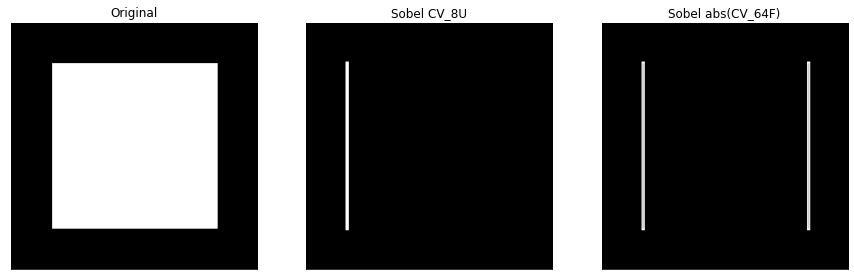

In [17]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

img = np.zeros((300, 300), np.uint8)
cv2.rectangle(img, (50, 50), (250, 250), 255, -2)

# Output dtype = cv2.CV_8U
sobelx8u = cv2.Sobel(img,cv2.CV_8U,1,0,ksize=5)

# Output dtype = cv2.CV_64F. Then take its absolute and convert to cv2.CV_8U
sobelx64f = cv2.Sobel(img,cv2.CV_64F,1,0,ksize=5)
abs_sobel64f = np.absolute(sobelx64f)
sobel_8u = np.uint8(abs_sobel64f)

plt.subplot(1,3,1),plt.imshow(img,cmap = 'gray')
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(1,3,2),plt.imshow(sobelx8u,cmap = 'gray')
plt.title('Sobel CV_8U'), plt.xticks([]), plt.yticks([])
plt.subplot(1,3,3),plt.imshow(sobel_8u,cmap = 'gray')
plt.title('Sobel abs(CV_64F)'), plt.xticks([]), plt.yticks([])

plt.show()

But as we saw these filters originally have the problem that they only work to find the edges at their highest point, that is, when the color values increase a lot quickly but it does not work for when the values decrease a lot suddenly, because their number is negative, but We can solve it by taking the absolute value of the response to obtain all the edges, this is an advantage since if the two filters are used independently of each other, they can be evaluated as X and Y vectors and get both the magnitude of the vector and its direction (that is, where there is more luminosity in the kernel)

Another way to get the complete edges is by using the second derivative, the second derivatives have the quality of crossing 0 after lowering the slope so that it would give us both the lower and upper edges, they are defined as follows:

the second derivative represents the growth, constancy or decrease of the primitive function

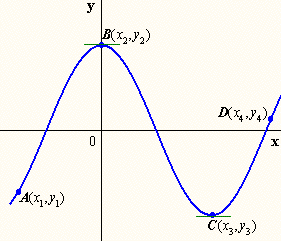



\begin{align*}
f''(a) = \lim_{h \to 0} \frac{f(a+h) - 2f(a) + f(a-h)}{h^2}
\end{align*}

In other words:<br>
a= measurement at one point<br>
h = distance between both measurements<br>
lim of h tends to 0 = when you move tending to 0, we cannot do this in an image so we do it with 1, so we can say that when the limit tends to the smallest unit of movement

With this, the equation means that we measure at the point where we are and multiply it by 2 (2f (a)) we add the measurement of a point back (f (ah)) and we subtract it from the measurement of a point in front (f (a + h)) and divide by the square of how much we moved to find the difference between the points

Applied in a kernel would look like this:

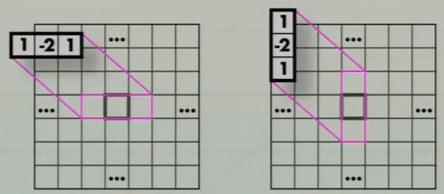



Respectively, for each of its axes, now using laplace which tells us that the derivative of a two-dimensional component is the sum of the partial derivatives of the two dimensions

\begin{align*}
\Delta f = \frac{\partial^2f}{\partial x^2} +\frac{\partial^2f}{\partial y^2}
\end{align*}

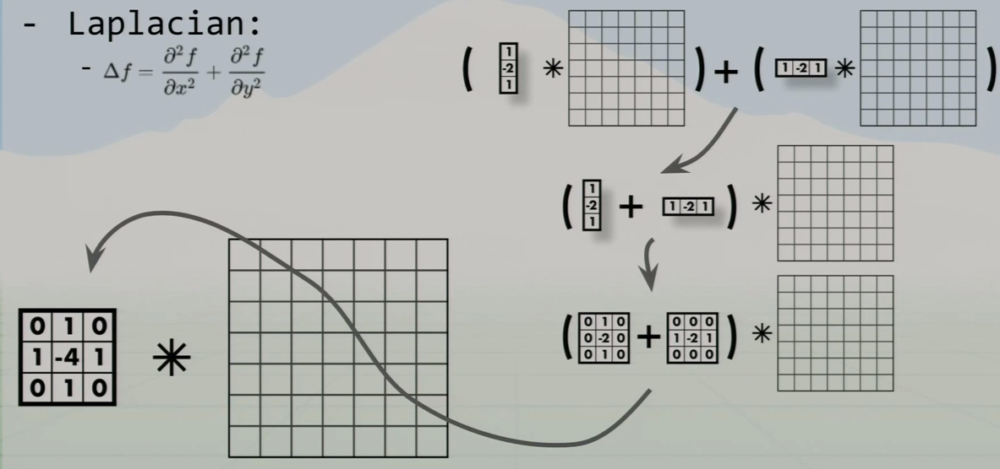



If you realize it is the same theorem of the properties of convolutions, only that for one of the theorems the filter is left with positive symbols and another with negative symbols, so in this specific problem it does not matter much if the positive symbol is used or negative, since we only look for drastic changes in the intensity of the image, resulting in:

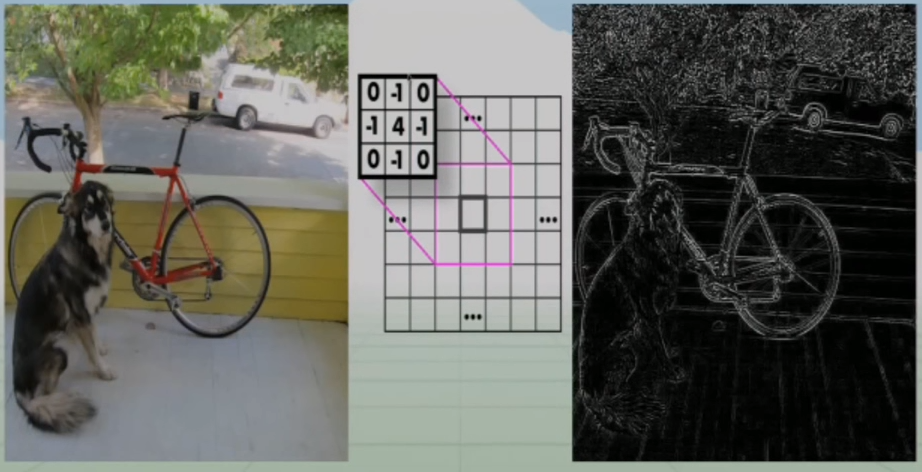



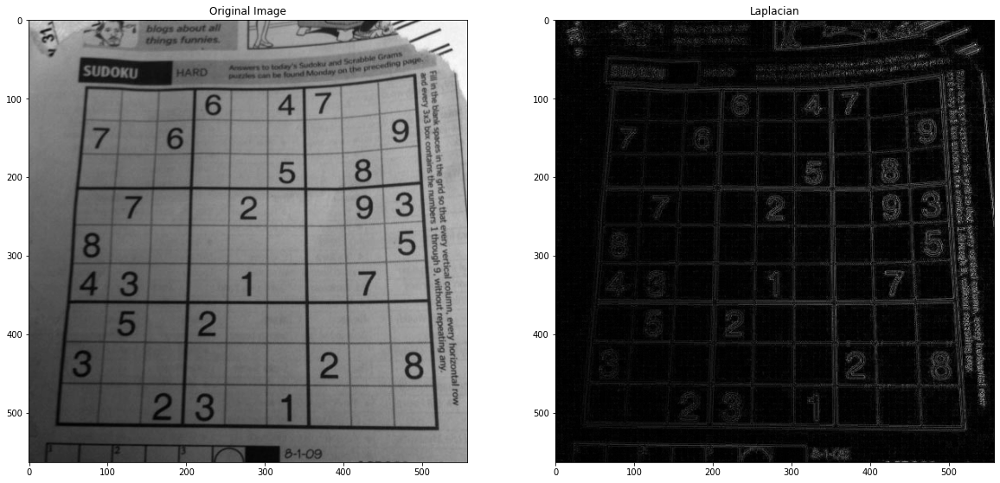

In [16]:
import numpy as np
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = [15, 30]

img = cv2.imread('Assets/sudoku.png', cv2.IMREAD_GRAYSCALE)

# the first argument is the image, the second is the format CV_64F is 64 bit float (a format that supports negative numbers) and the third parameter is the kernel size
lap = cv2.Laplacian(img, cv2.CV_64F, ksize=1)

# we return the image to the 8-bit format unsigned integer
lap = np.uint8(np.absolute(lap))

fig, axs = plt.subplots(1,2, figsize=(20, 10))
axs[0].set_title('Original Image')
axs[0].imshow(img, 'gray')
axs[1].set_title('Laplacian')
axs[1].imshow(lap, 'gray')
plt.show()

Another approach to this problem is the Gaussian difference (DoG)

This consists of the following, if we know that the edges are only the maximum points in a line, we can simply eliminate all the low frequency points and keep the edges, (remember that the gausse filter is not expressed as a blurrier (although if it is), it is expressed as a low pass filter (that is, it passes only the low frequencies)), but in practice it is used as follows:

is a feature enhancement algorithm that involves the subtraction of one Gaussian blurred version of an original image from another, less blurred version of the original. 

the blurred images are obtained by convolving the original grayscale images with Gaussian kernels having differing width (standard deviations). Blurring an image using a Gaussian kernel suppresses only high-frequency spatial information. Subtracting one image from the other preserves spatial information that lies between the range of frequencies that are preserved in the two blurred images.

\begin{align*}
g(f1)*I-g(f2)*I = (g(f1)-g(f2))*I
\end{align*}

In other words, the difference between two filters applied to the same image is the same as the difference between their standard deviations applied to an image

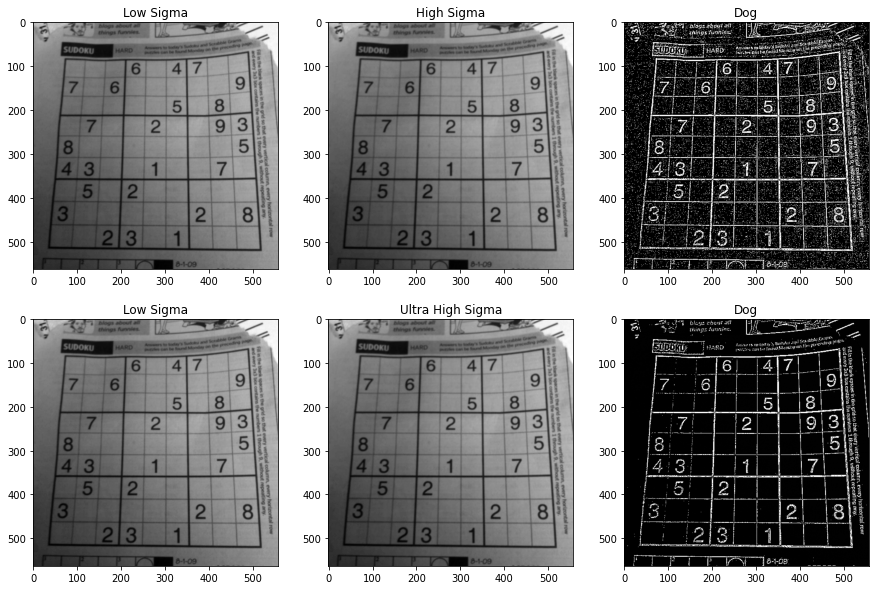

In [31]:
import numpy as np
from matplotlib import pyplot as plt

img = cv2.imread('Assets/sudoku.png', cv2.IMREAD_GRAYSCALE)

# Apply 3x3 and 7x7 Gaussian blur
low_sigma = cv2.GaussianBlur(img,(3,3),0)
high_sigma = cv2.GaussianBlur(img,(3,3),5)
Ultra_high_sigma = cv2.GaussianBlur(img,(3,3),25)
 
# Calculate the DoG by subtracting
dog = low_sigma - high_sigma
dog2 = low_sigma - Ultra_high_sigma

fig, axs = plt.subplots(2,3, figsize=(15, 10))
axs[0][0].set_title('Low Sigma')
axs[0][0].imshow(low_sigma, 'gray')
axs[0][1].set_title('High Sigma')
axs[0][1].imshow(high_sigma, 'gray')
axs[0][2].set_title('Dog')
axs[0][2].imshow(dog, 'gray')
axs[1][0].set_title('Low Sigma')
axs[1][0].imshow(low_sigma, 'gray')
axs[1][1].set_title('Ultra High Sigma')
axs[1][1].imshow(Ultra_high_sigma, 'gray')
axs[1][2].set_title('Dog')
axs[1][2].imshow(dog2, 'gray')
plt.show()

As we can see, this filter gives us each time only the most predominant edges in the image or rather those of the highest frequency when we increase the standard deviation.

we can continue mixing filters to obtain better visual results such as joining the intendity kernel and the Laplacian kernel to produce sharper images

<h2>Sharpen Kernel</h2>

<h3>Identity Kernel</h3>

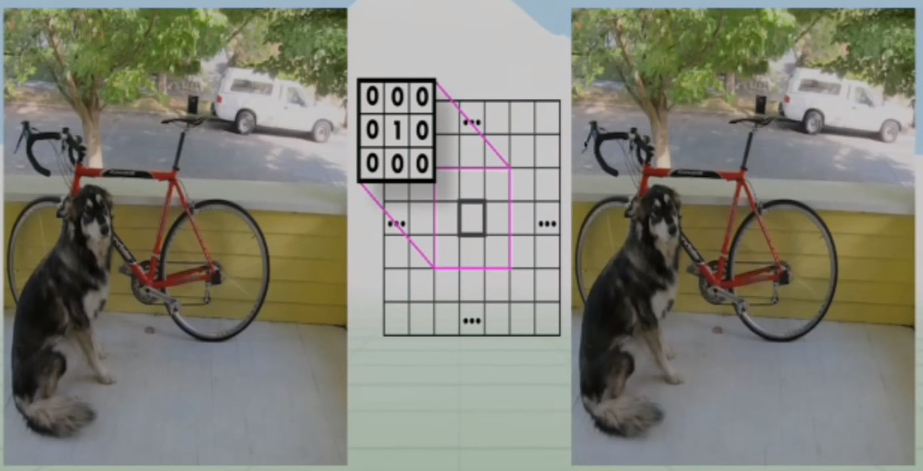



<h3>sharpens</h3>

Identity + Laplacian

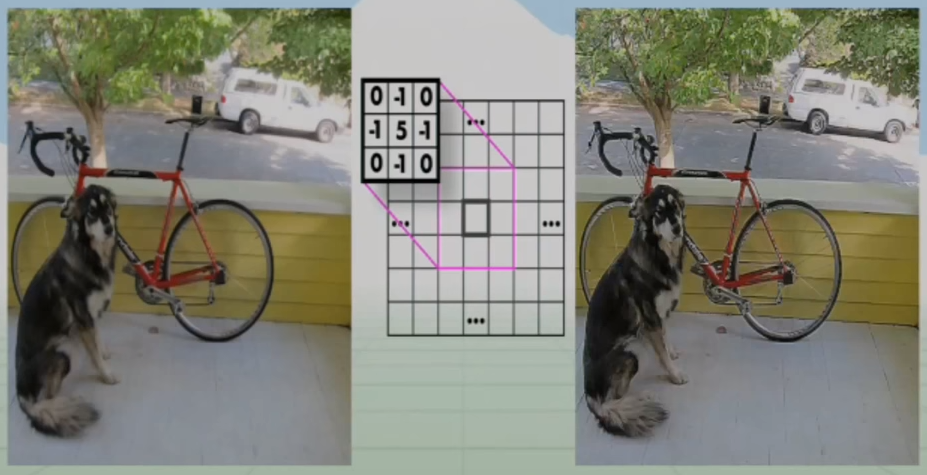



But all these methods do not help us to really use the edges because although it marks them in the image there are still many places where the edge could be because the thickness of the edges can sweep, or you can see very predominant but very small edges that does not really tell us anything about the image, what we really need is a single pixel line that tells us exactly where the important edges are, for this we can make a mixture of all the learned edge filters and their qualities

<h2>Canny Edge Detector</h2>

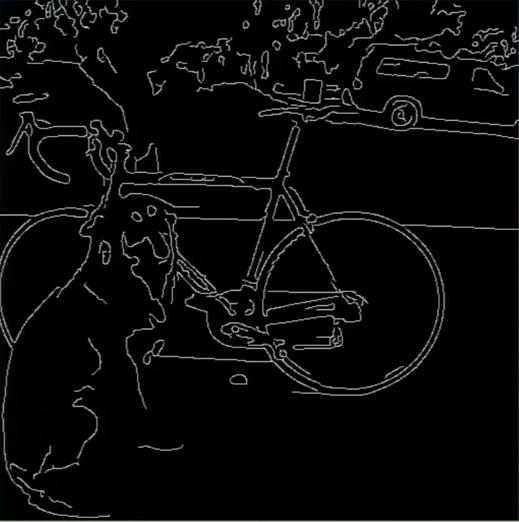



Canny Edge is a procedure that helps us to obtain this result

<b>Steps</b>:
- Blur the image (we only look for real edges not junk)
- Calculate magnitude and direction of radians (gradian map)
- Suppress the lowest values in the same direction as the gradient inside the kernel (non-maximum suppression)
- Draw the limits between strong edge, weak edge and no edge (Hysteresis Thresholding)
- Connect components

The first 3 steps can be summarized in drawing a map of gradients

- We first apply a gaussian filter to get rid of noise in the image
- Then we apply the super filters to obtain the magnitudes in 'X' and 'Y'
- We use the magnitudes of the vectors to get the total magnitude and the tangent to get the direction of the vector
- We suppress all the smallest pixels in the kernel leaving only the highest one in the vector direction

The formula to calculate the direction of vectors is:

\begin{align*}
\tan = \frac{Y}{X}
\end{align*}

The formula for the magnitude is:

\begin{align*}
M = \sqrt{(X_2 - X_1)^2 + (Y_2 - Y_1)^2}
\end{align*}

where x2-x1 squared and taking the root is just taking the absolute value of the subtraction of our pixels in the sobel filter for x and the same respectively for y so it is only the sum of the two magnitudes

Suppose we are in a kernel of (3x3) and when calculating its direction we find that the gradient is at 45 degrees in the horizontal

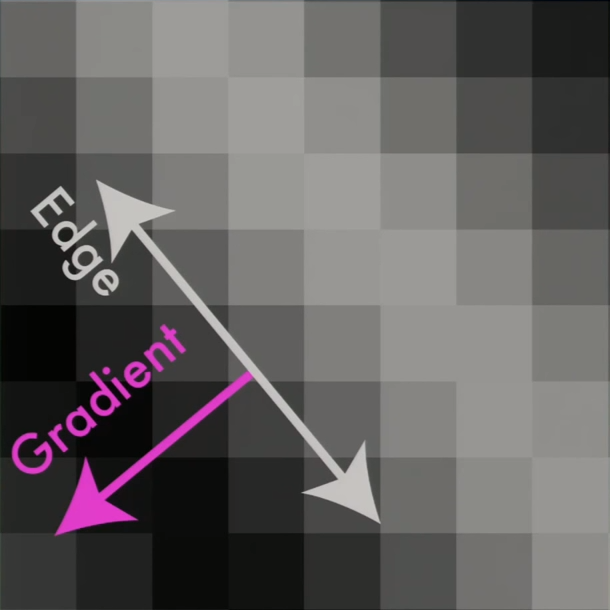



That means that the pixels that we will evaluate will be those that run in the same direction as the gradient, (those on both sides)

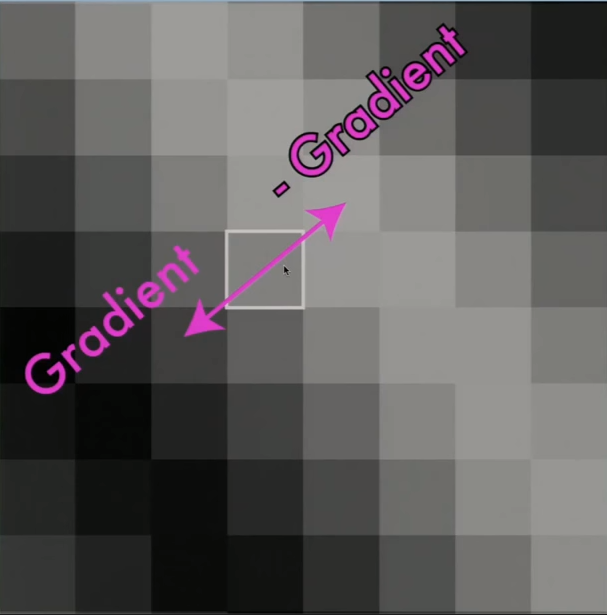



We can see that our pixel has a higher response than its lower neighbor but a lower response than its upper neighbor, this means that its response is not the highest in its kernel so it is sent to 0 (suppressing the values that are not the highest)

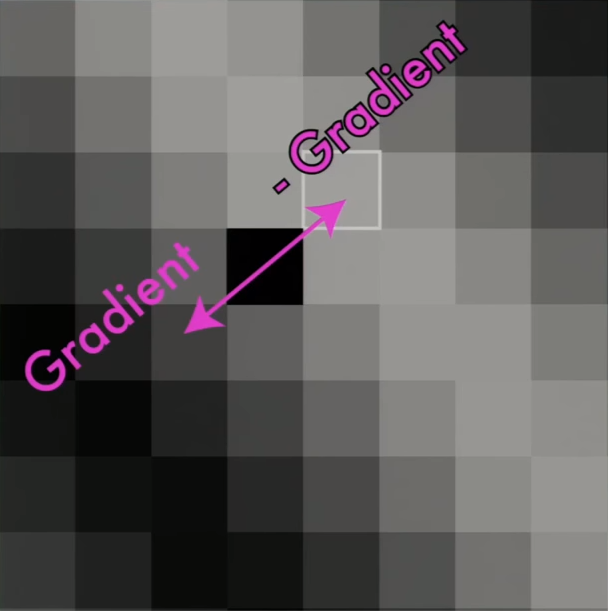



If we apply the same for all the pixels of the image we obtain the following result:

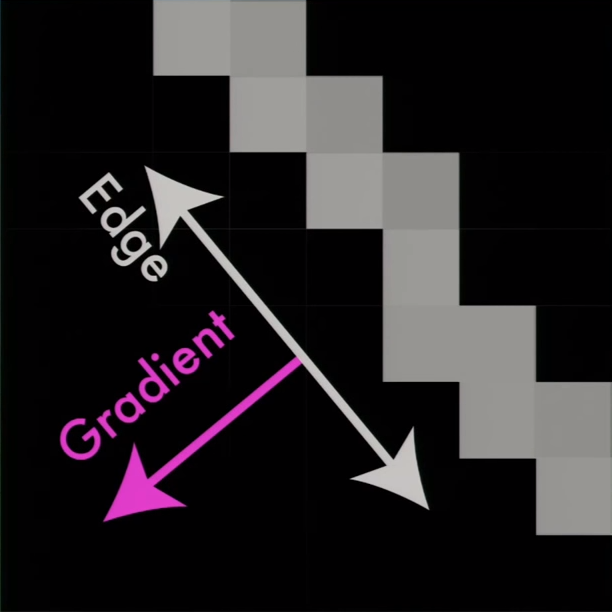



It is important to mention that an angle that fits perfectly in the pixels is not always found, so in practice two different ways are used to choose against which to compare the pixel

The first is to divide the possible angles in the area of the pixels with respect to the center

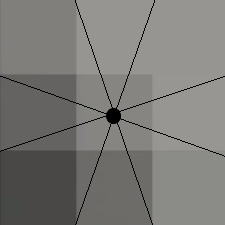



And the second is to interpolate the two pixels between which the angle falls to know the specific value with which the area of our pixels is compared (remember that it is not important to know which of the other pixels would be the largest because we are only interested in know if the pixel we are in is the highest, the procedure will be done for all pixels, it is also important to remember that the value of the pixels in their center are not really a square so we interpolate the values with respect to their center and compare with the center of our pixel)

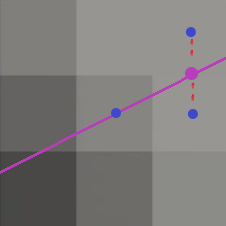



Up to here this procedure gives us the gradient map, but as we can see there are still many edges that do not interest us

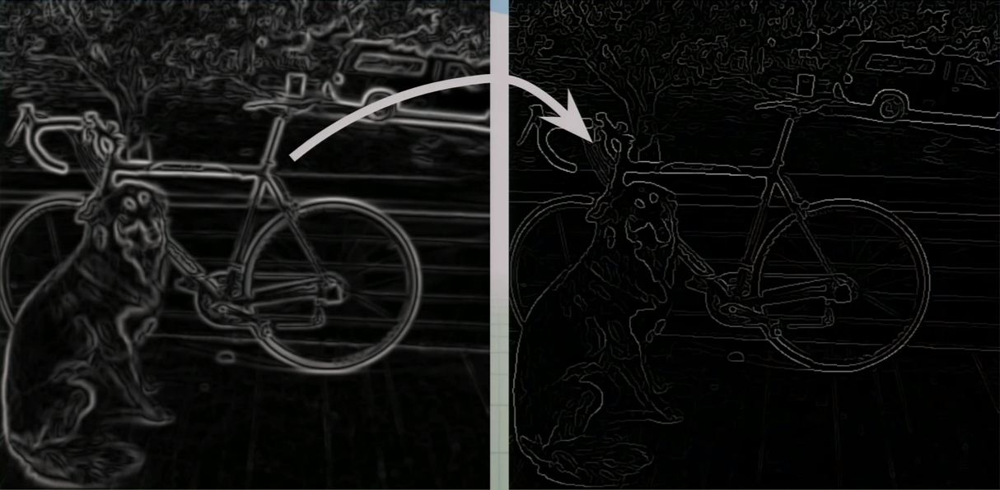



To eliminate these edges we apply the following two steps of Canny:
- Draw the boundaries between strong and weak edges, and no edges (Hysteresis Thresholding)
- Connect components

so we make two thresholds for 3 cases

This stage decides which are all edges are really edges and which are not. For this, we need two threshold values, minVal and maxVal. Any edges with intensity gradient more than maxVal are sure to be edges and those below minVal are sure to be non-edges, so discarded.

Those who lie between these two thresholds are classified edges or non-edges based on their connectivity. If they are connected to "sure-edge" pixels or is it close to these pixels (usually 8 pixels closer), they are considered to be part of edges. Otherwise, they are also discarded.

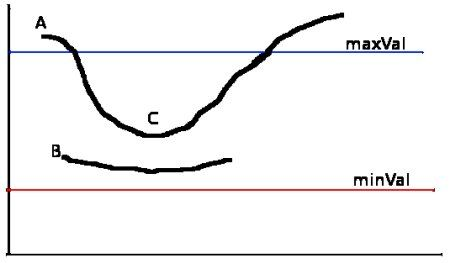



This is the last thing that is done in the algorithm, then you can only tune things like the sigma in the gauss filter (as we saw in the last approximation of the edges that indicates that we will only obtain the most pronounced edges if we use one higher sigma) or the thresholds that will be used (if we use a smaller one for the weak then the smaller frequencies will still be added but only if it connect to one of the big ones or things like that)

cv2.Canny(image, threshold1, threshold2, apertureSize, L2gradient)

Necessary parameters are:
- image: Source/Input image of n-dimensional array.
- threshold1: It is the High threshold value of intensity gradient.
- threshold2: It is the Low threshold value of intensity gradient.

Optional parameters are:
- ApertureSize: Order of Kernel(matrix) for the Sobel filter. Its default value is (3 x 3), and its value should be odd between 3 and 7. It is used for finding image gradients. Filter is used for smoothening and sharpening of an image.
- L2gradient: This specifies the equation for finding gradient magnitude. L2gradient is of boolean type, and its default value is False.

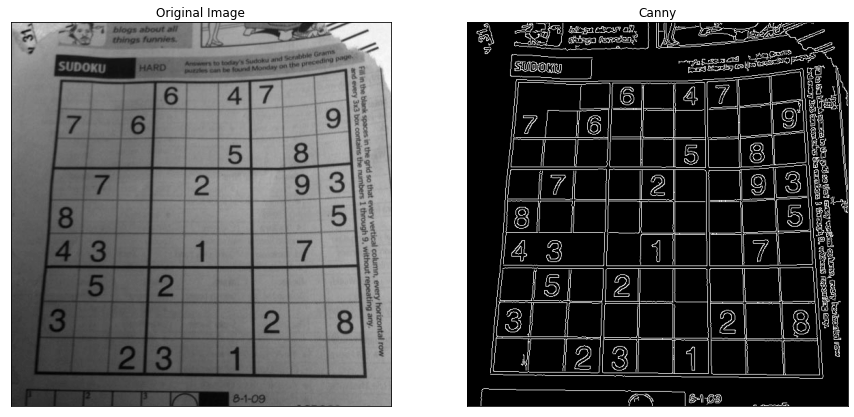

In [2]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = [15, 40]

img = cv2.imread('Assets/sudoku.png', cv2.IMREAD_GRAYSCALE)

canny = cv2.Canny(img,10,200)

titles = ['Original Image', 'Canny']
images = [img,canny]
for i in range(len(titles)):
    plt.subplot(2,2,i+1),plt.imshow(images[i], 'gray')
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([]) 
plt.show()

<b>Canny in a video</b>

Now let's try the same but in a video.

<b>Operation</b>: press a lowercase <b>'s'</b> to starts saving the video and a lowercase <b>'r'</b> to release it,  press <b>'ESC'</b> to quit.

In [2]:
import cv2
import numpy as np

cap = cv2.VideoCapture(0)
fourCC = cv2.VideoWriter_fourcc(*'XVID')
outCanny = cv2.VideoWriter('Assets/Canny.avi', fourCC, 20.0, (640,480))
outInvCanny = cv2.VideoWriter('Assets/InvCanny.avi', fourCC, 20.0, (640,480))

saveC = False
releaseC = False

while True:
    ret, image = cap.read()
    
    # Convert image to grayscale
    img_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Clean up image using Guassian Blur (for some reason the function don have the sigma and kernel for the gaussian as parameter)
    img_gray_blur = cv2.GaussianBlur(img_gray, (5,5), 0)
    
    # Extract edges
    canny_edges = cv2.Canny(img_gray_blur, 10, 70)
    
    # Do an invert binarize the image 
    ret, mask = cv2.threshold(canny_edges, 70, 255, cv2.THRESH_BINARY_INV)
        
    cv2.imshow('Canny', canny_edges)
    cv2.imshow('Inv-Canny', mask)
    
    if saveC:
        outCanny.write(cv2.cvtColor(canny_edges, cv2.COLOR_GRAY2RGB))
        outInvCanny.write(cv2.cvtColor(mask, cv2.COLOR_GRAY2RGB))
        
    if releaseC:
        outCanny.release()
        outInvCanny.release()
    
    key = cv2.waitKey(1) & 0xFF
    if key == 27:
        break      
    if key == ord('s'):
        saveC^=True # toggle the variable
    if key == ord('r'):
        releaseC^=True # toggle the variable
        
# Release camera and close windows
cap.release()
cv2.destroyAllWindows()     

<b>Author</b>: Amber Macias

<b>Sources:</b>

<i>The documents and web pages from which I only take images of concepts or small parts are not on this list, here are only the largest sources of information due to the fact that the material is very extensive</i>

The Ancient Secrets of Computer Vision - 04 - Resizing, Filtering, and Convolutions, Joseph Redmon:
https://www.youtube.com/watch?v=5xdbJ7z4Nrc&list=PLjMXczUzEYcHvw5YYSU92WrY8IwhTuq7p&index=4

The Ancient Secrets of Computer Vision -05 - Edges and Features, Joseph Redmon:
https://www.youtube.com/watch?v=z5WSV6CXsxs


Deep Learning Computer Vision™ CNN, OpenCV, YOLO, SSD & GANs, Rajeev D. Ratan:
https://www.udemy.com/course/master-deep-learning-computer-visiontm-cnn-ssd-yolo-gans/